#### Predicting future sales for a company is one of the most important aspects of strategic planning.

In this kernel, we will wanted analyze in depth how internal and external factors of one of the biggest companies in the US can affect their Weekly Sales in the future.

This module contains complete analysis of data , includes time series analysis , identifies the best performing stores , performs sales prediction with the help of multiple linear regression.

The data collected ranges from 2010 to 2012, where 45 Walmart stores across the country were included in this analysis. It is important to note that we also have external data available like CPI, Unemployment Rate and Fuel Prices in the region of each store which, hopefully, help us to make a more detailed analysis.

## <p style="background-color:white;font-family:newtimeroman;color:coral;font-size:170%;text-align:center;border-radius:20px 60px;">Let's dive in . . .</p>


### <p style="background-color:white;font-family:timesnewroman;color:lightseagreen;font-size:200%;border-radius:20px 60px;">Introduction</p> 
 
 #### In Retail Industry and chain of stores one of the biggest issue they face are supply chain management. The component of supply chain management (SCM) involved with determining how best to fulfill the requirements created from the Demand Plan. 
 
 *It's objective is to balance supply and demand in a manner that achieves the financial and service objectives of the enterprise.*
 
  If we look into the case of a retail chain stores one of the basic case is to know the demand of products that are sold in the store. If the decision making authority know whats the demand of each products for a week or month, they would be able to plan the supply chain accordingly. If that is possible this would save a lot of money for them because they don't have to overstock or can plan their Logistics accordingly.

 
### <p style="background-color:white;font-family:calibri;color:lightseagreen;font-size:200%;border-radius:20px 60px;">Data</p> 

### There are 3 Datasets :

#### Stores:¶

- Store: The store number. Range from 1–45.
- Type: Three types of stores ‘A’, ‘B’ or ‘C’.
- Size: Sets the size of a Store would be calculated by the no. of products available in the particular store ranging from 34,000 to 210,000.

***primary key is Store***
#### Sales:¶

- Date: The date of the week where this observation was taken.
- Weekly_Sales: The sales recorded during that Week.
- store: The store which observation in recorded 1–45
- Dept: One of 1–99 that shows the department.
- IsHoliday: Boolean value representing a holiday week or not.

***primary key is a combination of (Store,Dept,Date)***
#### Features:

- store: The store which observation in recorded 1–45
- Date: The date of the week where this observation was taken.
- Temperature: Temperature of the region during that week.
- Fuel_Price: Fuel Price in that region during that week.
- MarkDown1:5 : Represents the Type of markdown and what quantity was available during that week.
- CPI: Consumer Price Index during that week.
- Unemployment: The unemployment rate during that week in the region of the store.
- IsHoliday: Boolean value representing a holiday week or not.

***primary key here is a combination of (Store,Date)***



### <p style="background-color:white;font-family:calibri;color:lightseagreen;font-size:200%;border-radius:20px 60px;">Plan of Action</p> 

    1. We will perform detailed EDA & Time series analysis and gather useful insights
    2. Next we will build the following Regression models to predict future sales.
    
 
 **List of Models -**

# <p style="background-color:coral;font-family:newtimeroman;color:white;font-size:150%;text-align:center;border-radius:20px 60px;">Dataset Importing and Querying</p>

    We will load all 3 datasets and merge them  into one big dataset that gives whole data. 

### Note :

*Since here we are only predicting Store level sales we will group the dataframes such that Department level data gets eliminated and take the sum of department level sales to give the store level sales.*

In [93]:
import warnings 
warnings.filterwarnings('ignore')

import time
t = time.time()

print('Importing startred...')

# base libraries
import os
import numpy as np
import pandas as pd
import re
from scipy import stats
from random import randint
from datetime import datetime


# visualization libraries
import matplotlib.pyplot as plt
import matplotlib 
%matplotlib inline
import seaborn as sns
#import missingno as msno
import plotly.express as px


# preprocessing libraries
from sklearn.model_selection import (TimeSeriesSplit,
                                     GridSearchCV,
                                     RandomizedSearchCV,
                                     train_test_split, 
                                     KFold, 
                                     StratifiedKFold,
                                    cross_val_score)

from sklearn.preprocessing import (LabelEncoder,
                                   StandardScaler, 
                                   MinMaxScaler, 
                                   OrdinalEncoder)
from sklearn.svm import SVR
from sklearn.feature_selection import SelectFromModel


# metrics
from sklearn.metrics import (mean_squared_error, 
                             r2_score, 
                             mean_absolute_error)
from sklearn.metrics import make_scorer


# modeling algos
from sklearn.linear_model import (LogisticRegression,
                                  Lasso, 
                                  ridge_regression,
                                  LinearRegression)
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import (AdaBoostRegressor, 
                              RandomForestRegressor,
                              VotingRegressor, 
                              GradientBoostingRegressor)
from sklearn.linear_model import Ridge, RidgeCV, Lasso, LassoCV
from mlxtend.regressor import StackingCVRegressor
from xgboost import XGBRegressor
from lightgbm import (LGBMRegressor,
                      early_stopping)

from sklearn.base import clone ## sklearn base models for stacked ensemble model
from sklearn.pipeline import make_pipeline


print('Done, All the required modules are imported. Time elapsed: {}sec'.format(time.time()-t))

Importing startred...
Done, All the required modules are imported. Time elapsed: 0.0054836273193359375sec


#### Load and read data

In [94]:
walmart_train = pd.read_csv('train.csv')
walmart_feature = pd.read_csv('features.csv')
walmart_store = pd.read_csv('stores.csv')
walmart_test = pd.read_csv('test.csv')


In [95]:
print(walmart_train.columns)
print(walmart_feature.columns)
print(walmart_test.columns)

Index(['Store', 'Dept', 'Date', 'Weekly_Sales', 'IsHoliday'], dtype='object')
Index(['Store', 'Date', 'Temperature', 'Fuel_Price', 'MarkDown1', 'MarkDown2',
       'MarkDown3', 'MarkDown4', 'MarkDown5', 'CPI', 'Unemployment',
       'IsHoliday'],
      dtype='object')
Index(['Store', 'Dept', 'Date', 'IsHoliday'], dtype='object')


In [96]:
walmart_test.head()

,Store,Dept,Date,IsHoliday
0,1,1,2012-11-02,False
1,1,1,2012-11-09,False
2,1,1,2012-11-16,False
3,1,1,2012-11-23,True
4,1,1,2012-11-30,False


In [97]:
walmart_train.head()

,Store,Dept,Date,Weekly_Sales,IsHoliday
0,1,1,2010-02-05,24924.50,False
1,1,1,2010-02-12,46039.49,True
2,1,1,2010-02-19,41595.55,False
3,1,1,2010-02-26,19403.54,False
4,1,1,2010-03-05,21827.90,False


#### Merging all the datasets into one place for easier test and analysis.

In [98]:
result = pd.merge(walmart_train, walmart_store, how='inner', on='Store', left_on=None, right_on=None,
        left_index=False, right_index=False, sort=False,
        suffixes=('_x', '_y'), copy=True, indicator=False)

data = pd.merge(result, walmart_feature, how='inner', on=['Store','Date','IsHoliday'], left_on=None, right_on=None,
        left_index=False, right_index=False, sort=False,
        suffixes=('_x', '_y'), copy=False, indicator=False)

In [99]:
result.head()

,Store,Dept,Date,Weekly_Sales,IsHoliday,Type,Size
0,1,1,2010-02-05,24924.50,False,A,151315
1,1,1,2010-02-12,46039.49,True,A,151315
2,1,1,2010-02-19,41595.55,False,A,151315
3,1,1,2010-02-26,19403.54,False,A,151315
4,1,1,2010-03-05,21827.90,False,A,151315


In [100]:
result1 = pd.merge(walmart_test, walmart_store, how='inner', on='Store', left_on=None, right_on=None,
        left_index=False, right_index=False, sort=False,
        suffixes=('_x', '_y'), copy=True, indicator=False)

test = pd.merge(result1, walmart_feature, how='inner', on=['Store','Date','IsHoliday'], left_on=None, right_on=None,
        left_index=False, right_index=False, sort=False,
        suffixes=('_x', '_y'), copy=False, indicator=False)

# <p style="background-color:coral;font-family:newtimeroman;color:white;font-size:120%;text-align:center;border-radius:20px 60px;">Data Cleaning</p>

<p style="background-color:white;font-family:calibri;color:lightseagreen;font-size:200%;border-radius:20px 60px;">Now let's look through the data and do some basic data cleaning</p> 


In [101]:
print(data.head())
print(test.head())

   Store  Dept        Date  Weekly_Sales  IsHoliday Type    Size  Temperature  \
0      1     1  2010-02-05      24924.50      False    A  151315        42.31   
1      1     2  2010-02-05      50605.27      False    A  151315        42.31   
2      1     3  2010-02-05      13740.12      False    A  151315        42.31   
3      1     4  2010-02-05      39954.04      False    A  151315        42.31   
4      1     5  2010-02-05      32229.38      False    A  151315        42.31   

   Fuel_Price  MarkDown1  MarkDown2  MarkDown3  MarkDown4  MarkDown5  \
0       2.572        NaN        NaN        NaN        NaN        NaN   
1       2.572        NaN        NaN        NaN        NaN        NaN   
2       2.572        NaN        NaN        NaN        NaN        NaN   
3       2.572        NaN        NaN        NaN        NaN        NaN   
4       2.572        NaN        NaN        NaN        NaN        NaN   

          CPI  Unemployment  
0  211.096358         8.106  
1  211.096358       

In [102]:
print(data.shape)
print(test.shape)

(421570, 16)
(115064, 15)


In [103]:
# % of missing.
for col in data.columns:
    pct_missing = np.mean(data[col].isnull())
    print('{} - {}%'.format(col, round(pct_missing*100)))

Store - 0%
Dept - 0%
Date - 0%
Weekly_Sales - 0%
IsHoliday - 0%
Type - 0%
Size - 0%
Temperature - 0%
Fuel_Price - 0%
MarkDown1 - 64%
MarkDown2 - 74%
MarkDown3 - 67%
MarkDown4 - 68%
MarkDown5 - 64%
CPI - 0%
Unemployment - 0%


<Figure size 640x480 with 0 Axes>

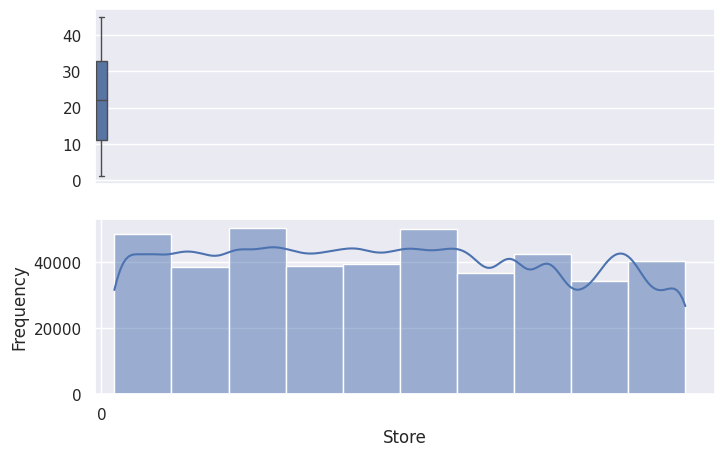

<Figure size 800x500 with 0 Axes>

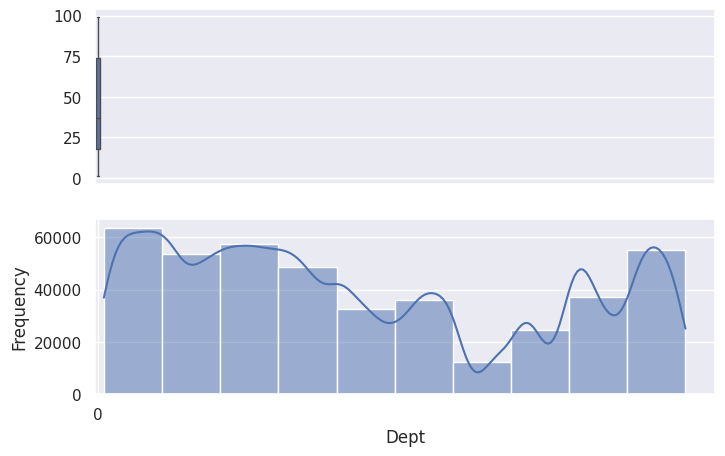

<Figure size 800x500 with 0 Axes>

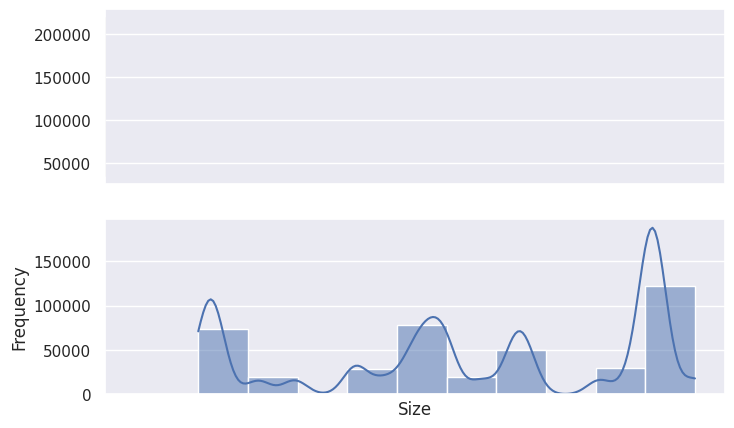

<Figure size 800x500 with 0 Axes>

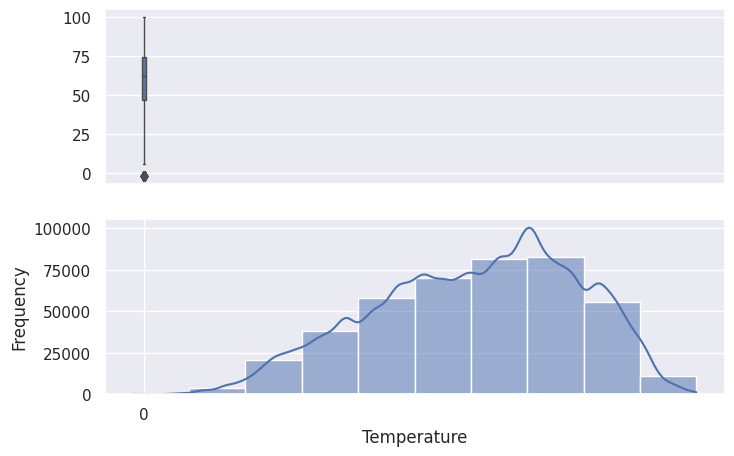

<Figure size 800x500 with 0 Axes>

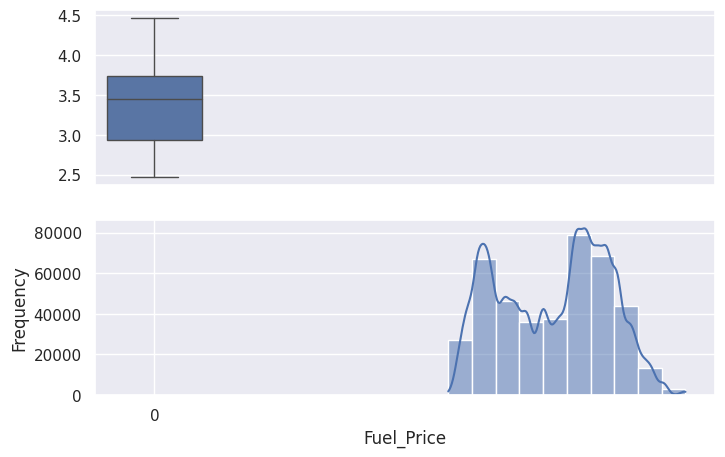

<Figure size 800x500 with 0 Axes>

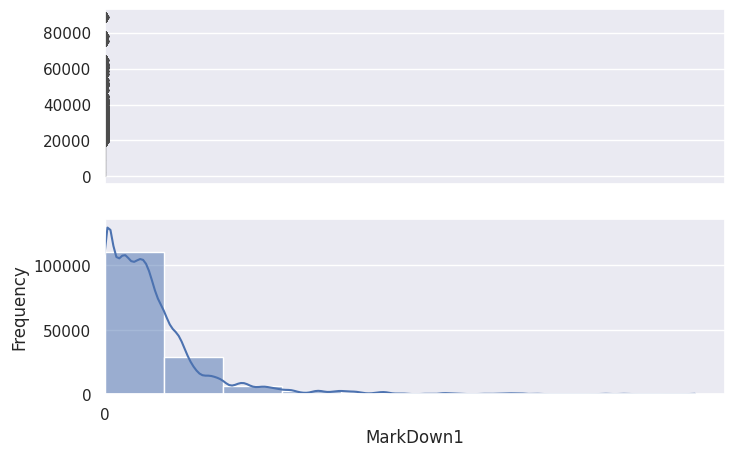

<Figure size 800x500 with 0 Axes>

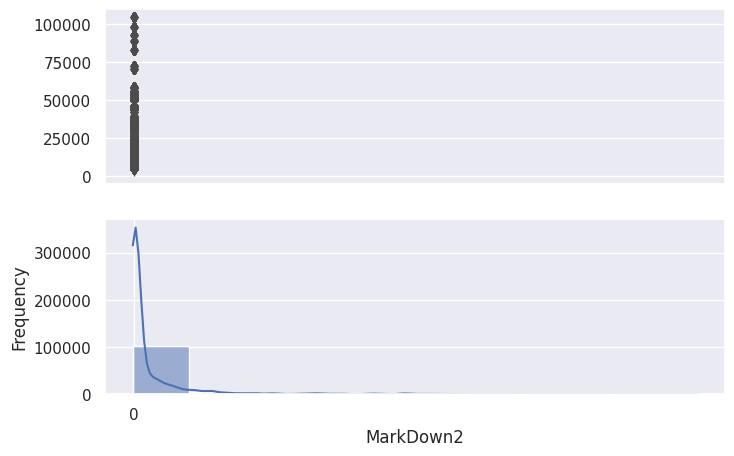

<Figure size 800x500 with 0 Axes>

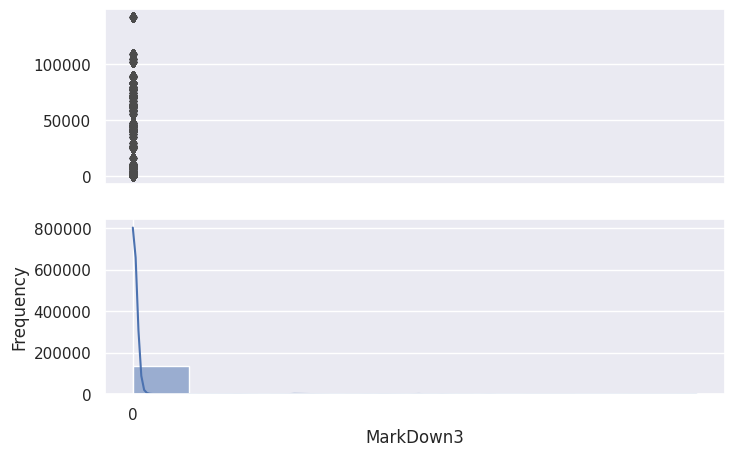

<Figure size 800x500 with 0 Axes>

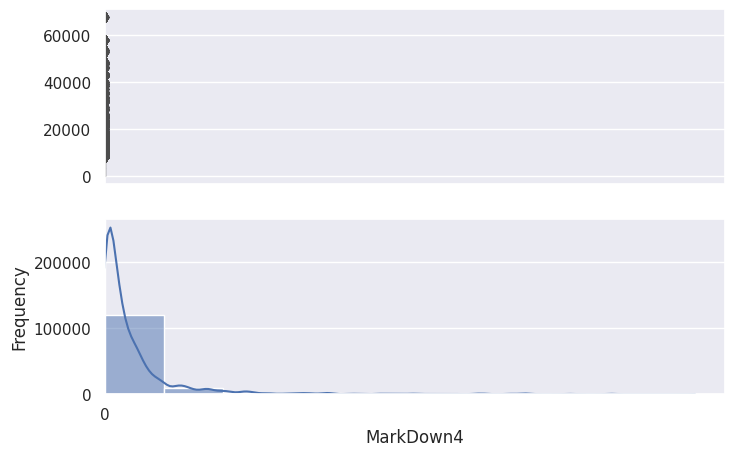

<Figure size 800x500 with 0 Axes>

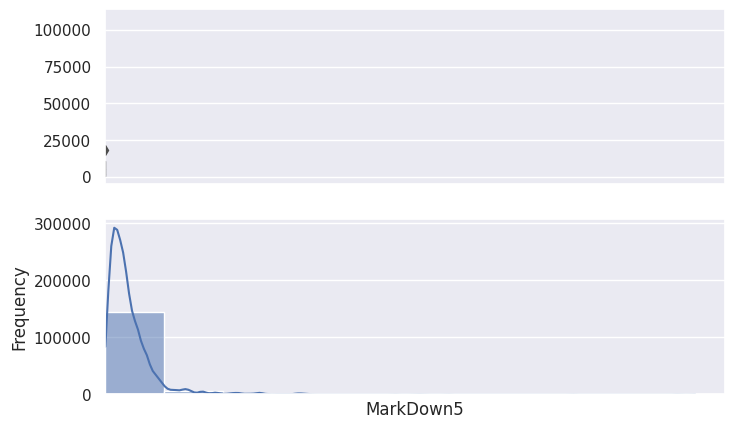

<Figure size 800x500 with 0 Axes>

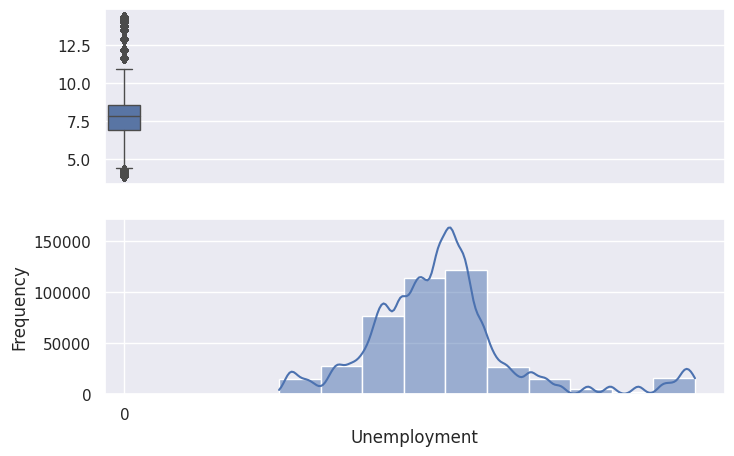

<Figure size 800x500 with 0 Axes>

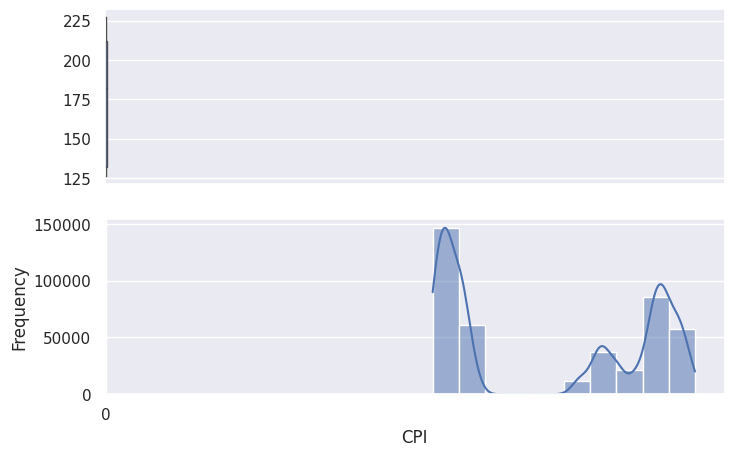

In [104]:
#Irregular Data (Outliers) 

columns = ['Store','Dept' ,'Size','Temperature' ,'Fuel_Price' ,'MarkDown1','MarkDown2','MarkDown3','MarkDown4','MarkDown5','Unemployment','CPI']

for i in columns:
    plt.figure()
    plt.tight_layout()
    sns.set(rc={"figure.figsize":(8, 5)})
    f, (ax_box, ax_hist) = plt.subplots(2, sharex=True)
    plt.gca().set(xlabel= i,ylabel='Frequency')
    sns.boxplot(data[i], ax=ax_box , linewidth= 1.0)
    sns.histplot(data[i], ax=ax_hist , bins = 10,kde=True)

In [105]:
print(data.describe())#result is numeric because there are no categorial columns
print(test.describe())

               Store           Dept   Weekly_Sales           Size  \
count  421570.000000  421570.000000  421570.000000  421570.000000   
mean       22.200546      44.260317   15981.258123  136727.915739   
std        12.785297      30.492054   22711.183519   60980.583328   
min         1.000000       1.000000   -4988.940000   34875.000000   
25%        11.000000      18.000000    2079.650000   93638.000000   
50%        22.000000      37.000000    7612.030000  140167.000000   
75%        33.000000      74.000000   20205.852500  202505.000000   
max        45.000000      99.000000  693099.360000  219622.000000   

         Temperature     Fuel_Price      MarkDown1      MarkDown2  \
count  421570.000000  421570.000000  150681.000000  111248.000000   
mean       60.090059       3.361027    7246.420196    3334.628621   
std        18.447931       0.458515    8291.221345    9475.357325   
min        -2.060000       2.472000       0.270000    -265.760000   
25%        46.680000       2.9330

In [106]:
# FINDING UNIQUE VALUE FOR CATEGORIAL COLUMNS IN TRAIN
for i in ['Store','Dept','Fuel_Price','Unemployment']:#,'Day','Month','Year']:
    print(f'{i}: {data[i].nunique()}')

Store: 45
Dept: 81
Fuel_Price: 892
Unemployment: 349


In [107]:
# FINDING UNIQUE VALUE FOR CATEGORIAL COLUMNS IN TEST
for i in ['Store','Dept','Fuel_Price','Unemployment']:#,'Day','Month','Year']:
    print(f'{i}: {test[i].nunique()}')

Store: 45
Dept: 81
Fuel_Price: 297
Unemployment: 89


In [108]:
# GETTING THE DATA TYPES+
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 421570 entries, 0 to 421569
Data columns (total 16 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   Store         421570 non-null  int64  
 1   Dept          421570 non-null  int64  
 2   Date          421570 non-null  object 
 3   Weekly_Sales  421570 non-null  float64
 4   IsHoliday     421570 non-null  bool   
 5   Type          421570 non-null  object 
 6   Size          421570 non-null  int64  
 7   Temperature   421570 non-null  float64
 8   Fuel_Price    421570 non-null  float64
 9   MarkDown1     150681 non-null  float64
 10  MarkDown2     111248 non-null  float64
 11  MarkDown3     137091 non-null  float64
 12  MarkDown4     134967 non-null  float64
 13  MarkDown5     151432 non-null  float64
 14  CPI           421570 non-null  float64
 15  Unemployment  421570 non-null  float64
dtypes: bool(1), float64(10), int64(3), object(2)
memory usage: 68.0+ MB


In [109]:
# GETTING THE DATA TYPES+
test.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 115064 entries, 0 to 115063
Data columns (total 15 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   Store         115064 non-null  int64  
 1   Dept          115064 non-null  int64  
 2   Date          115064 non-null  object 
 3   IsHoliday     115064 non-null  bool   
 4   Type          115064 non-null  object 
 5   Size          115064 non-null  int64  
 6   Temperature   115064 non-null  float64
 7   Fuel_Price    115064 non-null  float64
 8   MarkDown1     114915 non-null  float64
 9   MarkDown2     86437 non-null   float64
 10  MarkDown3     105235 non-null  float64
 11  MarkDown4     102176 non-null  float64
 12  MarkDown5     115064 non-null  float64
 13  CPI           76902 non-null   float64
 14  Unemployment  76902 non-null   float64
dtypes: bool(1), float64(9), int64(3), object(2)
memory usage: 13.3+ MB


In [110]:
#let's encode the categorical column : IsHoliday

data['IsHoliday'] = data['IsHoliday'].apply(lambda x: 1 if x == True else 0)
# Will convert the bool to 1 and 0 for easier use later.
#data.IsHoliday=data.IsHoliday.map(lambda x: 1 if x==True else 0)

test['IsHoliday'] = test['IsHoliday'].apply(lambda x: 1 if x == True else 0)

In [111]:
# Lets look into the null values
print(data.isnull().sum())
print(test.isnull().sum())

Store                0
Dept                 0
Date                 0
Weekly_Sales         0
IsHoliday            0
Type                 0
Size                 0
Temperature          0
Fuel_Price           0
MarkDown1       270889
MarkDown2       310322
MarkDown3       284479
MarkDown4       286603
MarkDown5       270138
CPI                  0
Unemployment         0
dtype: int64
Store               0
Dept                0
Date                0
IsHoliday           0
Type                0
Size                0
Temperature         0
Fuel_Price          0
MarkDown1         149
MarkDown2       28627
MarkDown3        9829
MarkDown4       12888
MarkDown5           0
CPI             38162
Unemployment    38162
dtype: int64


**Wow!! Now that's huge. More Than 65% of value are missing in MarkDown values**

*We can impute sum values as of now for the missing  and will later decide  whether to use Markdown for modeling or should take some other approach for imputing or whether to discard MarkDowns completely*


For the test data, we have null values in CPI and Unemployment as well

In [112]:
# converting the date to the required format
data['Date'] = pd.to_datetime(data['Date'])
#add a 'week' column to the dataset for further analysis
data['Week'] = data['Date'].dt.week
#add a 'quarter' column to the dataset for further analysis
data['quarter'] = data['Date'].dt.quarter
#add a 'year',  'month','Day' column to the dataset for further analysis
data['year'] = data['Date'].dt.year
data['month'] = data['Date'].dt.month
data['day'] = data['Date'].dt.day

In [113]:
# converting the date to the required format
test['Date'] = pd.to_datetime(test['Date'])
#add a 'week' column to the dataset for further analysis
test['Week'] = test['Date'].dt.week
#add a 'quarter' column to the dataset for further analysis
test['quarter'] = test['Date'].dt.quarter
#add a 'year',  'month','Day' column to the dataset for further analysis
test['year'] = test['Date'].dt.year
test['month'] = test['Date'].dt.month
test['day'] = test['Date'].dt.day

In [114]:
data.head()

,Store,Dept,Date,Weekly_Sales,IsHoliday,Type,Size,Temperature,Fuel_Price,MarkDown1,...,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,Week,quarter,year,month,day
0,1,1,2010-02-05,24924.50,0,A,151315,42.31,2.572,NaN,...,NaN,NaN,NaN,211.096358,8.106,5,1,2010,2,5
1,1,2,2010-02-05,50605.27,0,A,151315,42.31,2.572,NaN,...,NaN,NaN,NaN,211.096358,8.106,5,1,2010,2,5
2,1,3,2010-02-05,13740.12,0,A,151315,42.31,2.572,NaN,...,NaN,NaN,NaN,211.096358,8.106,5,1,2010,2,5
3,1,4,2010-02-05,39954.04,0,A,151315,42.31,2.572,NaN,...,NaN,NaN,NaN,211.096358,8.106,5,1,2010,2,5
4,1,5,2010-02-05,32229.38,0,A,151315,42.31,2.572,NaN,...,NaN,NaN,NaN,211.096358,8.106,5,1,2010,2,5


In [115]:
test.head()

,Store,Dept,Date,IsHoliday,Type,Size,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,Week,quarter,year,month,day
0,1,1,2012-11-02,0,A,151315,55.32,3.386,6766.44,5147.7,50.82,3639.9,2737.42,223.462779,6.573,44,4,2012,11,2
1,1,2,2012-11-02,0,A,151315,55.32,3.386,6766.44,5147.7,50.82,3639.9,2737.42,223.462779,6.573,44,4,2012,11,2
2,1,3,2012-11-02,0,A,151315,55.32,3.386,6766.44,5147.7,50.82,3639.9,2737.42,223.462779,6.573,44,4,2012,11,2
3,1,4,2012-11-02,0,A,151315,55.32,3.386,6766.44,5147.7,50.82,3639.9,2737.42,223.462779,6.573,44,4,2012,11,2
4,1,5,2012-11-02,0,A,151315,55.32,3.386,6766.44,5147.7,50.82,3639.9,2737.42,223.462779,6.573,44,4,2012,11,2


In [116]:
# FINDING UNIQUE VALUE FOR CATEGORIAL COLUMNS IN TRAIN
    
    
for col in ['Week','quarter','year','month','day']:
    print(f'{col}: {data[col].unique()}')
    

Week: [ 5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52
  1  2  3  4]
quarter: [1 2 3 4]
year: [2010 2011 2012]
month: [ 2  3  4  5  6  7  8  9 10 11 12  1]
day: [ 5 12 19 26  2  9 16 23 30  7 14 21 28  4 11 18 25  6 13 20 27  3 10 17
 24  1  8 15 22 29 31]


In [117]:
# FINDING UNIQUE VALUE FOR CATEGORIAL COLUMNS IN Test
    
    
for col in ['Week','quarter','year','month','day']:
    print(f'{col}: {test[col].unique()}')
    

Week: [44 45 46 47 48 49 50 51 52  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15
 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30]
quarter: [4 1 2 3]
year: [2012 2013]
month: [11 12  1  2  3  4  5  6  7]
day: [ 2  9 16 23 30  7 14 21 28  4 11 18 25  1  8 15 22 29  5 12 19 26  3 10
 17 24 31]


# EXPLORATORY DATA ANALYSIS(EDA)


**A histogram is representation of the distribution of numerical data, where the data are binned and the count for each bin is represented. More generally, in Plotly a histogram is an aggregated bar chart, with several possible aggregation functions (e.g. sum, average, count...) which can be used to visualize data on categorical and date axes as well as linear axes.**

In [118]:
fig = px.histogram(data, x='Temperature', y ='Weekly_Sales', color='IsHoliday')#,color = "red")#, marginal='box')
fig.show()
# corelating the temperatue and weekly sales

Low temperature and High temperature are effecting the sales and holiday doesn't have huge impact on the sales based on the temparature.

In [119]:
fig = px.histogram(data, x='Unemployment', y ='Weekly_Sales',color='IsHoliday', title = 'How Unemployment affect sales')
fig.show()

During the low Unemployment and high unemployment rate - weekly sales is less,assuming the average median value for unemployment(7.874) there is no proper correlation can be done.Further analysis is done under Time series analysis.

In [120]:
px.histogram(data, x='Fuel_Price', y ='Weekly_Sales', color='IsHoliday')

In [121]:
px.histogram(data, x='CPI', y ='Weekly_Sales', color='IsHoliday')

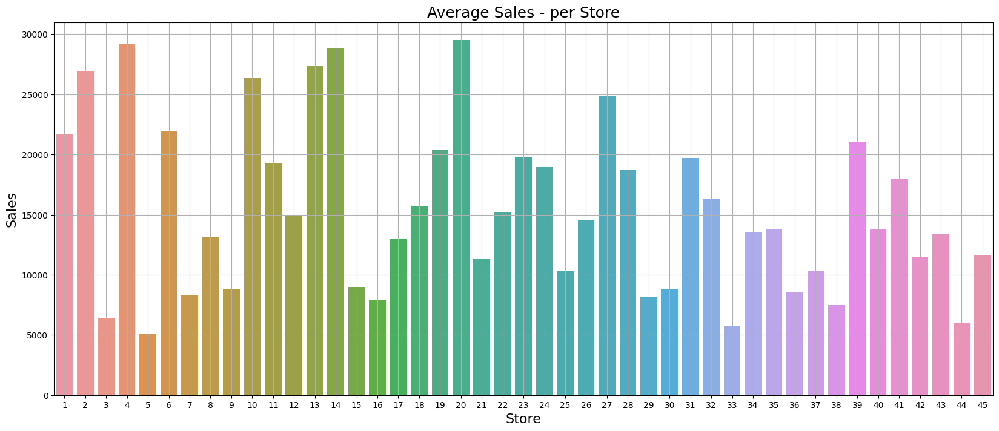

In [122]:
weekly_sales = data['Weekly_Sales'].groupby(data['Store']).mean()
plt.figure(figsize=(20,8))
plt.style.use('default')
sns.barplot(x=weekly_sales.index,y=weekly_sales.values)
plt.grid()
plt.title('Average Sales - per Store', fontsize=18)
plt.ylabel('Sales', fontsize=16)
plt.xlabel('Store', fontsize=16)
plt.show()

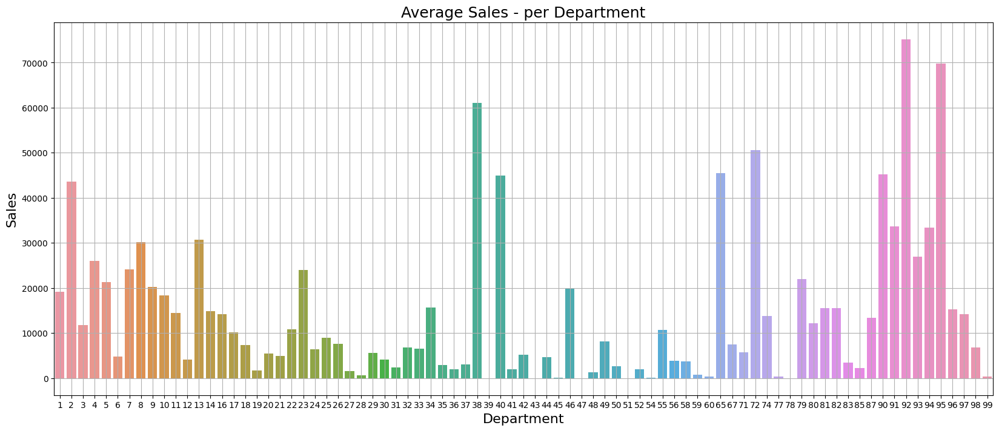

In [123]:
weekly_sales = data['Weekly_Sales'].groupby(data['Dept']).mean()
plt.figure(figsize=(20,8))
plt.style.use('default')
sns.barplot(x=weekly_sales.index,y=weekly_sales.values)
plt.grid()
plt.title('Average Sales - per Department', fontsize=18)
plt.ylabel('Sales', fontsize=16)
plt.xlabel('Department', fontsize=16)
plt.show()

In [124]:
#Create a dataframe for heatmap
data_heatmap_df=data.copy()

# Eliminating all the columns that are not continuous/binary  variables from the heatmap section.
data_heatmap_df.drop(['Store','day','month','year','Date','Type'], axis=1,inplace=True)


# Lets look the correlation matrix and heat map of the 

## Correlation Heat map
def correlation_heat_map(df):
    corrs = df.corr()

    # Set the default matplotlib figure size:
    fig, ax = plt.subplots(figsize=(12,8))

    # Generate a mask for the upper triangle (taken from seaborn example gallery)
    mask = np.zeros_like(corrs, dtype=np.bool_)
    mask[np.triu_indices_from(mask)] = True

    # Plot the heatmap with seaborn.
    # Assign the matplotlib axis the function returns. This will let us resize the labels.
    ax = sns.heatmap(corrs, mask=mask, annot=True, cmap='Pastel1_r')

    # Resize the labels.
    ax.set_xticklabels(ax.xaxis.get_ticklabels(), fontsize=14, rotation=90)
    ax.set_yticklabels(ax.yaxis.get_ticklabels(), fontsize=14, rotation=0)

    # If you put plt.show() at the bottom, it prevents those useless printouts from matplotlib.
    plt.show()


<p style="background-color:white;font-family:timesnewroman;color:lightseagreen;font-size:200%;border-radius:20px 60px;"> Statistical analysis and correlations</p>

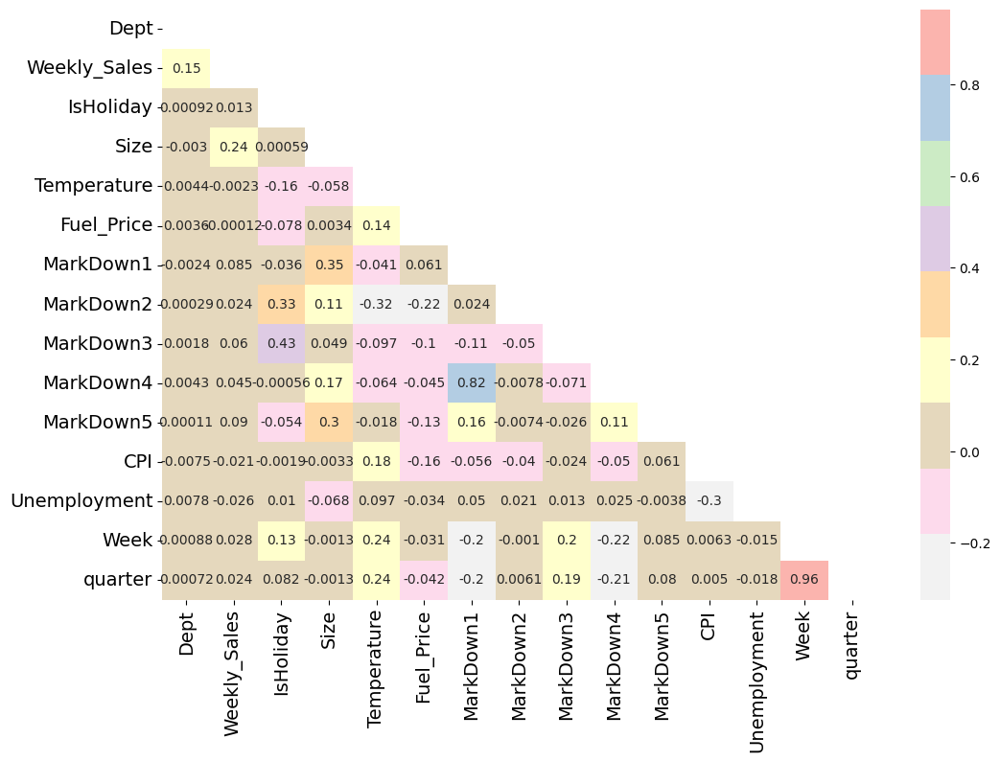

In [125]:
correlation_heat_map(data_heatmap_df)

#inference: By checking the direct correlation of features there is no much promising correlations. 
#           There are no much correlation within the features as well. In a way this is good because 
#           there won't be multicollinearity that we have to take care while running models.


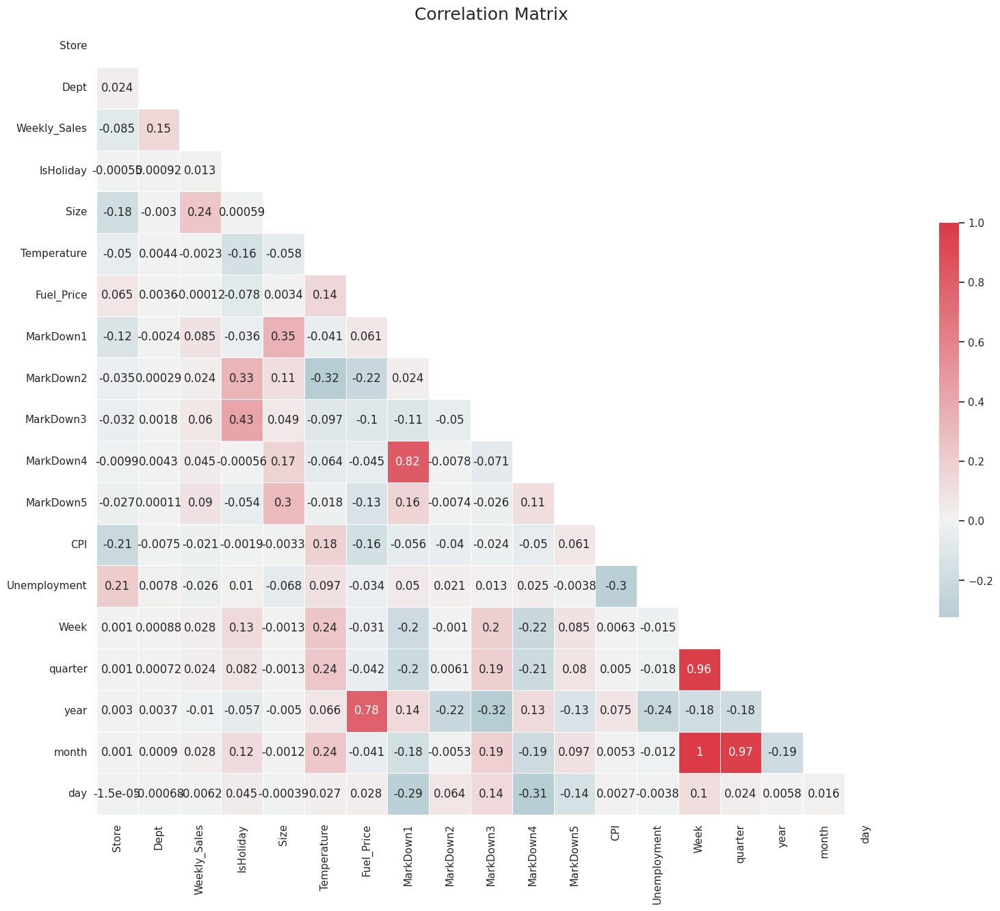

In [126]:
sns.set(style="white")

corr = data.corr()
mask = np.triu(np.ones_like(corr, dtype=np.bool_))
f, ax = plt.subplots(figsize=(20, 15))
cmap = sns.diverging_palette(220, 10, as_cmap=True)
plt.title('Correlation Matrix', fontsize=18)
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True)

plt.show()

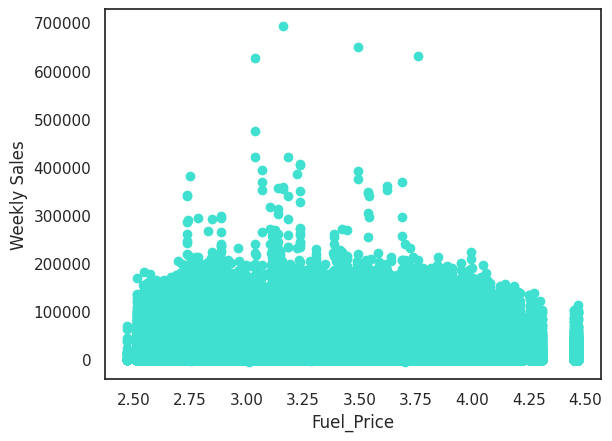

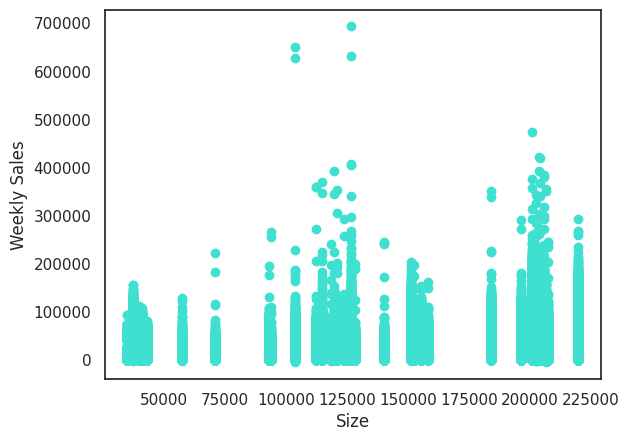

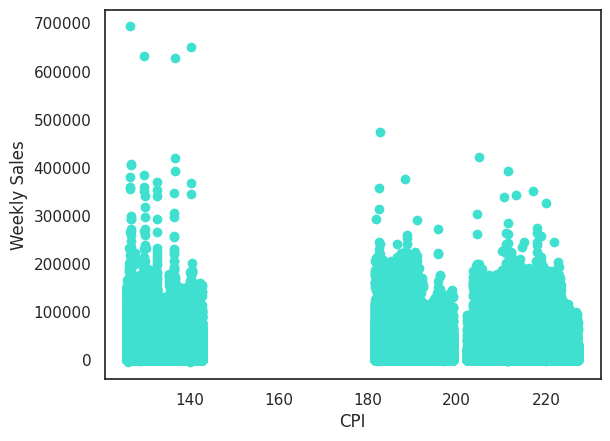

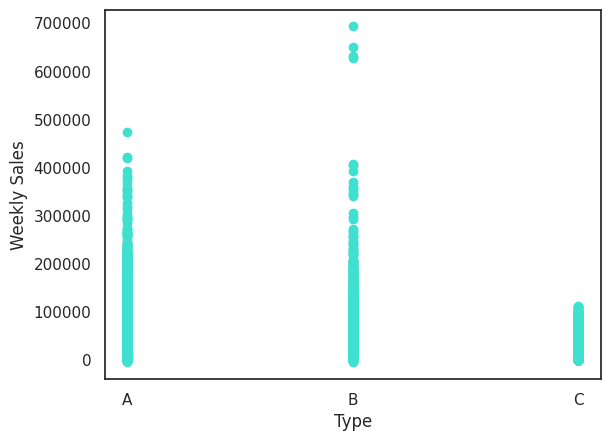

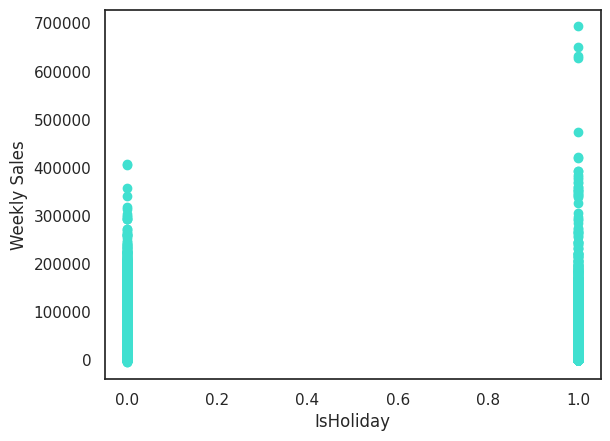

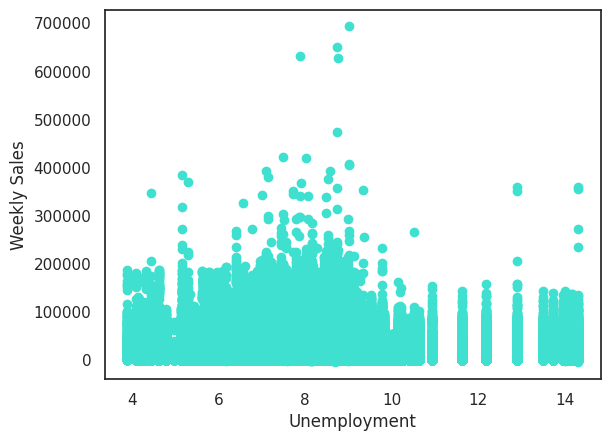

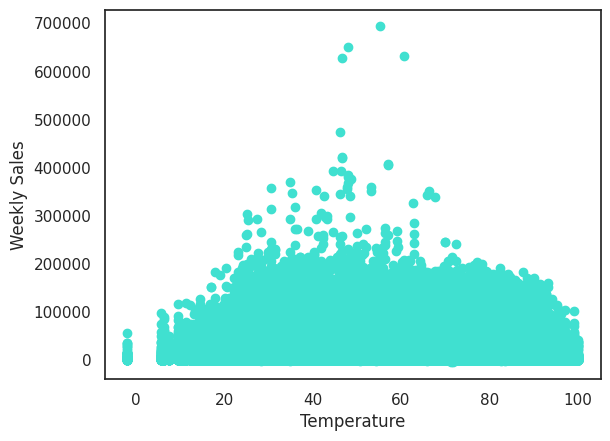

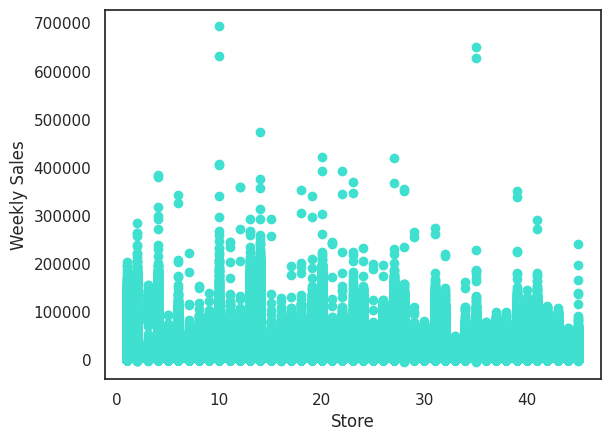

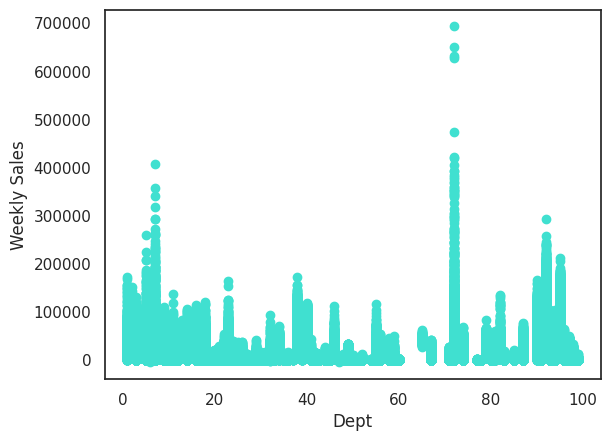

In [127]:
def scatter(dataset, column):
    plt.figure()
    plt.scatter(data[column] , data['Weekly_Sales'], color = 'turquoise')
    plt.ylabel('Weekly Sales')
    plt.xlabel(column)

scatter(data, 'Fuel_Price')
scatter(data, 'Size')
scatter(data, 'CPI')
scatter(data, 'Type')
scatter(data, 'IsHoliday')
scatter(data, 'Unemployment')
scatter(data, 'Temperature')
scatter(data, 'Store')
scatter(data, 'Dept')


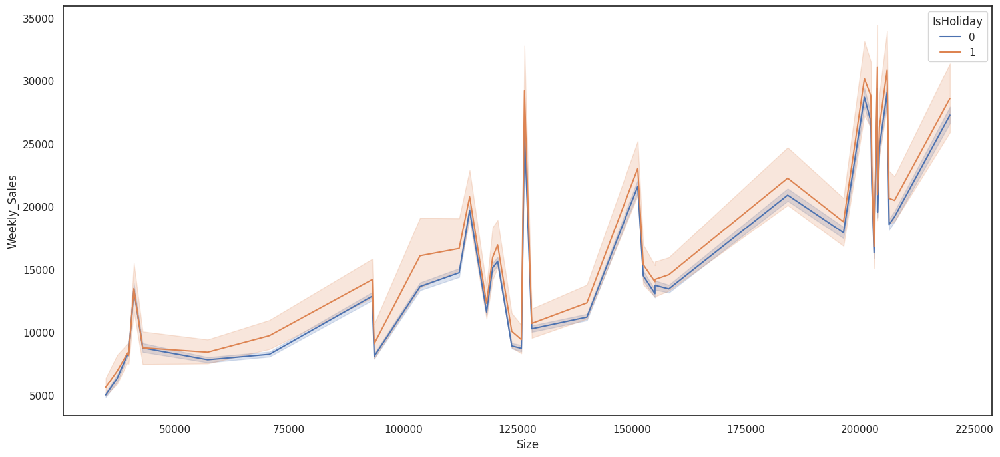

In [128]:
plt.figure(figsize=(18,8))
sns.lineplot( data = data, x = 'Size', y =  'Weekly_Sales', hue = 'IsHoliday');

**The distplot figure factory displays a combination of statistical representations of numerical data, such as histogram, kernel density estimation or normal curve, and rug plot**

In [129]:
import plotly.graph_objs as go
from plotly import tools

fig = go.Figure()
df_weeks = data.groupby('Week').sum()
#fig.add_trace(go.Scatter( x = df_weeks.index, y = df_weeks['Weekly_Sales'], name = 'Weekly Sales', mode = 'lines') )
fig.add_trace(go.Scatter( x = df_weeks.index, y = df_weeks['MarkDown1'], name = 'MarkDown1', mode = 'lines') )
fig.add_trace(go.Scatter( x = df_weeks.index, y = df_weeks['MarkDown2'], name = 'MarkDown2', mode = 'lines') )
fig.add_trace(go.Scatter( x = df_weeks.index, y = df_weeks['MarkDown3'], name = 'MarkDown3', mode = 'lines') )
fig.add_trace(go.Scatter( x = df_weeks.index, y = df_weeks['MarkDown4'], name = 'MarkDown4', mode = 'lines') )
fig.add_trace(go.Scatter( x = df_weeks.index, y = df_weeks['MarkDown5'], name = 'MarkDown5', mode = 'lines') )
fig.update_layout(title = 'Sales vs Markdown', xaxis_title = 'Weeks')

In [130]:
## setting all missing values in markdown columns to -500 for now. We will treat them later while performing Feature scaling
data['MarkDown1'].fillna(-500, inplace=True)
data['MarkDown2'].fillna(-500, inplace=True)
data['MarkDown3'].fillna(-500, inplace=True)
data['MarkDown4'].fillna(-500, inplace=True)
data['MarkDown5'].fillna(-500, inplace=True)

In [131]:
## setting all missing values in markdown columns to -500 for now. We will treat them later while performing Feature scaling
test['MarkDown1'].fillna(-500, inplace=True)
test['MarkDown2'].fillna(-500, inplace=True)
test['MarkDown3'].fillna(-500, inplace=True)
test['MarkDown4'].fillna(-500, inplace=True)
test['MarkDown5'].fillna(-500, inplace=True)


# <p style="background-color:coral;font-family:newtimeroman;color:white;font-size:150%;text-align:center;border-radius:20px 60px;">Detailed Time-Series Analysis</p>


<p style="background-color:white;font-family:calibri;color:lightseagreen;font-size:200%;border-radius:20px 60px;"> What is Time Series</p> 

Any data recorded with some fixed interval of time is called as time series data. This fixed interval can be hourly, daily, monthly or yearly. e.g. hourly temp reading, daily changing fuel prices, monthly electricity bill, annul company profit report etc. In time series data, time will always be independent variable and there can be one or many dependent variable. 

Sales forecasting time series with shampoo sales for every month will look like this, 

![Shampoo_Sales](https://raw.githubusercontent.com/satishgunjal/images/master/Shampoo_Sales.png)

In above example since there is only one variable dependent on time so its called as univariate time series. If there are multiple dependent variables, then its called as multivariate time series.

Objective of time series analysis is to understand how change in time affect the dependent variables and accordingly predict values for future time intervals.

<p style="background-color:white;font-family:timesnewroman;color:lightseagreen;font-size:200%;border-radius:20px 60px;"> Stationarity Data</p> 

For accurate analysis and forecasting trend and seasonality is removed from the time series and converted it into stationary series.
Time series data is said to be stationary when statistical properties like mean, standard deviation are constant and there is no seasonality. In other words statistical properties of the time series data should not be a function of time.

![Stationarity](https://raw.githubusercontent.com/satishgunjal/images/master/Stationarity.png)

<p style="background-color:white;font-family:timesnewroman;color:lightseagreen;font-size:200%;border-radius:20px 60px;"> Test for Stationarity</p>

Easy way is to look at the plot and look for any obvious trend or seasonality. While working on real world data we can also use more sophisticated methods like rolling statistic and Augmented Dickey Fuller test to check stationarity of the data. 

### Rolling Statistics <a id ="11"></a>
In rolling statistics technique we define a size of window to calculate the mean and standard deviation throughout the series. For stationary series mean and standard deviation shouldn't change with time.

<p style="background-color:white;font-family:timesnewroman;color:lightseagreen;font-size:200%;border-radius:20px 60px;"> Augmented Dickey Fuller (ADF) Test</p>

I won't go into the details of how this test works. I will concentrate more on how to interpret the result of this test to determine the stationarity of the series. ADF test will return 'p-value' and 'Test Statistics' output values.
* **p-value > 0.05**: non-stationary.
* **p-value <= 0.05**: stationary.
* **Test statistics**: More negative this value more likely we have stationary series. Also, this value should be smaller than critical values(1%, 5%, 10%). For e.g. If test statistic is smaller than the 5% critical values, then we can say with 95% confidence that this is a stationary series


![](https://i.pinimg.com/originals/cc/fe/1f/ccfe1f7fee5fe18a65127d4ed1f4c036.gif)


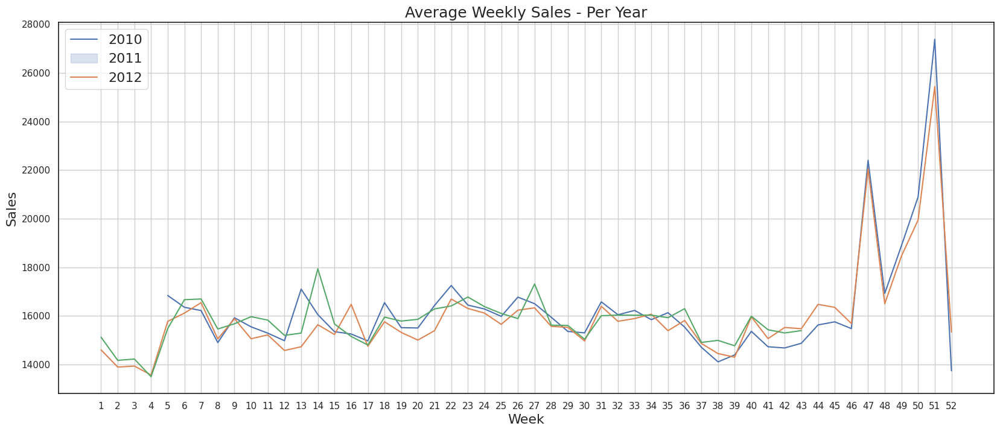

In [132]:
weekly_sales_2010 = data[data.year==2010]['Weekly_Sales'].groupby(data['Week']).mean()
weekly_sales_2011 = data[data.year==2011]['Weekly_Sales'].groupby(data['Week']).mean()
weekly_sales_2012 = data[data.year==2012]['Weekly_Sales'].groupby(data['Week']).mean()
plt.figure(figsize=(20,8))
sns.lineplot(x=weekly_sales_2010.index,y=weekly_sales_2010.values)
sns.lineplot(x=weekly_sales_2011.index,y=weekly_sales_2011.values)
sns.lineplot(x=weekly_sales_2012.index,y=weekly_sales_2012.values)
plt.grid()
plt.xticks(np.arange(1, 53, step=1))
plt.legend(['2010', '2011', '2012'], loc='best', fontsize=16)
plt.title('Average Weekly Sales - Per Year', fontsize=18)
plt.ylabel('Sales', fontsize=16)
plt.xlabel('Week', fontsize=16)
plt.show()


In [133]:
monthly_sales = data['Weekly_Sales'].groupby(data['month']).sum()
print(monthly_sales)


month
1     3.325984e+08
2     5.687279e+08
3     5.927859e+08
4     6.468598e+08
5     5.571256e+08
6     6.226299e+08
7     6.500010e+08
8     6.130902e+08
9     5.787612e+08
10    5.847848e+08
11    4.130157e+08
12    5.768386e+08
Name: Weekly_Sales, dtype: float64


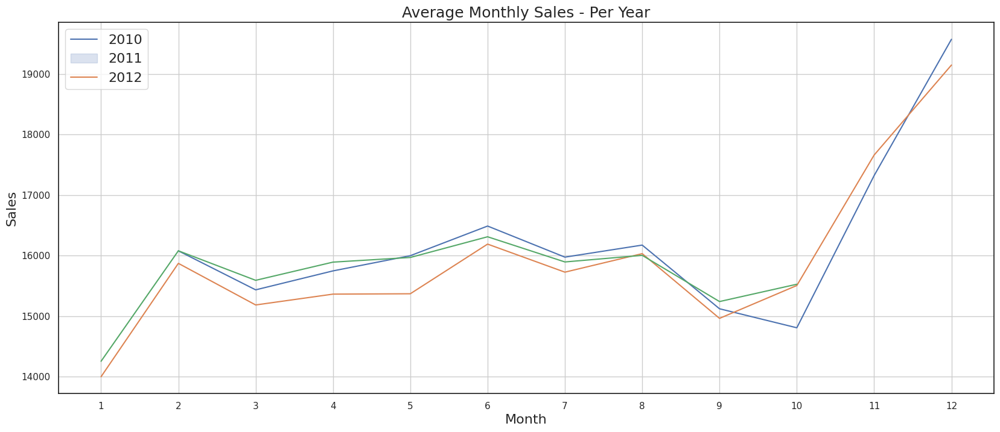

In [134]:
monthly_sales_2010 = data[data.year==2010]['Weekly_Sales'].groupby(data['month']).mean()
monthly_sales_2011 = data[data.year==2011]['Weekly_Sales'].groupby(data['month']).mean()
monthly_sales_2012 = data[data.year==2012]['Weekly_Sales'].groupby(data['month']).mean()
plt.figure(figsize=(20,8))
sns.lineplot(x=monthly_sales_2010.index,y=monthly_sales_2010.values)
sns.lineplot(x=monthly_sales_2011.index,y=monthly_sales_2011.values)
sns.lineplot(x=monthly_sales_2012.index,y=monthly_sales_2012.values)
plt.grid()
plt.xticks(np.arange(1, 13, step=1))
plt.legend(['2010', '2011', '2012'], loc='best', fontsize=16)
plt.title('Average Monthly Sales - Per Year', fontsize=18)
plt.ylabel('Sales', fontsize=16)
plt.xlabel('Month', fontsize=16)
plt.show()


#### Note :

**As we can see, there is one important Holiday not included in 'IsHoliday'. It's the Easter Day. It is always in a Sunday, but can fall on different weeks.**

In 2010 is in Week 13

In 2011, Week 16

Week 14 in 2012

Week 13 in 2013 for **Test set**

**So, we can change to 'True' these Weeks in each Year.**

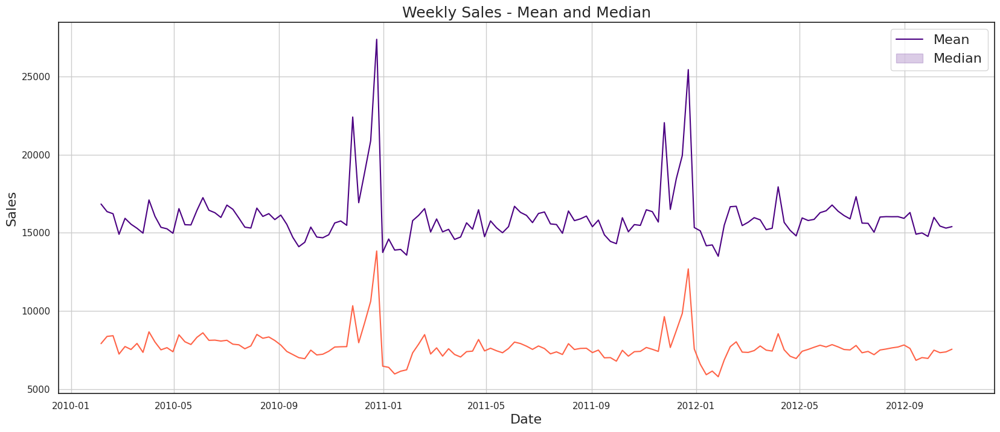

In [135]:
weekly_sales_mean = data['Weekly_Sales'].groupby(data['Date']).mean()
weekly_sales_median = data['Weekly_Sales'].groupby(data['Date']).median()
plt.figure(figsize=(20,8))
sns.lineplot(x=weekly_sales_mean.index,y=weekly_sales_mean.values, color = 'indigo')
sns.lineplot(x=weekly_sales_median.index,y=weekly_sales_median.values, color = 'tomato')
plt.grid()
plt.legend(['Mean', 'Median'], loc='best', fontsize=16)
plt.title('Weekly Sales - Mean and Median', fontsize=18)
plt.ylabel('Sales', fontsize=16)
plt.xlabel('Date', fontsize=16)
plt.show()

**# converting days and months from numerics to categories**

In [136]:
days = {0:'Sunday',1:'Monday',2:'Tuesday',3:'Wednesday',4:'Thursday',5: 'Friday',6:'Saturday'}
data['day'] = data['day'].map(days)
months={1:'January',2:'February',3:'March',4:'April',5:'May',6:'June',7:'July',8:'August',9:'September',10:'October',11:'Novemenber',12:'December'}
data['month']= data['month'].map(months)
data.head()

,Store,Dept,Date,Weekly_Sales,IsHoliday,Type,Size,Temperature,Fuel_Price,MarkDown1,...,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,Week,quarter,year,month,day
0,1,1,2010-02-05,24924.50,0,A,151315,42.31,2.572,-500.0,...,-500.0,-500.0,-500.0,211.096358,8.106,5,1,2010,February,Friday
1,1,2,2010-02-05,50605.27,0,A,151315,42.31,2.572,-500.0,...,-500.0,-500.0,-500.0,211.096358,8.106,5,1,2010,February,Friday
2,1,3,2010-02-05,13740.12,0,A,151315,42.31,2.572,-500.0,...,-500.0,-500.0,-500.0,211.096358,8.106,5,1,2010,February,Friday
3,1,4,2010-02-05,39954.04,0,A,151315,42.31,2.572,-500.0,...,-500.0,-500.0,-500.0,211.096358,8.106,5,1,2010,February,Friday
4,1,5,2010-02-05,32229.38,0,A,151315,42.31,2.572,-500.0,...,-500.0,-500.0,-500.0,211.096358,8.106,5,1,2010,February,Friday


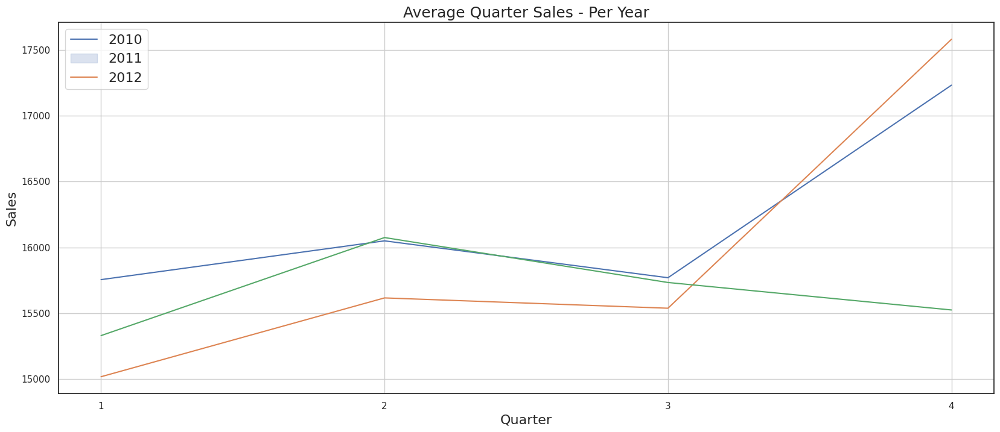

In [137]:
quarter_sales_2010 = data[data.year==2010]['Weekly_Sales'].groupby(data['quarter']).mean()
quarter_sales_2011 = data[data.year==2011]['Weekly_Sales'].groupby(data['quarter']).mean()
quarter_sales_2012 = data[data.year==2012]['Weekly_Sales'].groupby(data['quarter']).mean()
plt.figure(figsize=(20,8))
sns.lineplot(x=quarter_sales_2010.index, y=quarter_sales_2010.values)
sns.lineplot(x=quarter_sales_2011.index, y=quarter_sales_2011.values)
sns.lineplot(x=quarter_sales_2012.index, y=quarter_sales_2012.values)
plt.grid()
plt.xticks(np.arange(1, 5, step=1))
plt.legend(['2010', '2011', '2012'], loc='best', fontsize=16)
plt.title('Average Quarter Sales - Per Year', fontsize=18)
plt.ylabel('Sales', fontsize=16)
plt.xlabel('Quarter', fontsize=16)
plt.show()


In [138]:
yearly_sales = data.groupby('year').sum()
yearly_sales['Weekly_Sales']

year
2010    2.288886e+09
2011    2.448200e+09
2012    2.000133e+09
Name: Weekly_Sales, dtype: float64

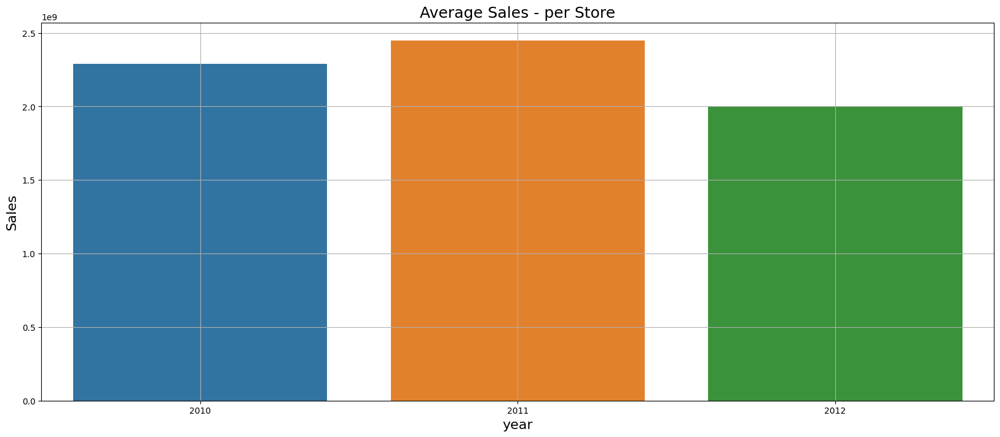

In [139]:
plt.figure(figsize=(20,8))
plt.style.use('default')
sns.barplot(x = yearly_sales.index, y = yearly_sales['Weekly_Sales'])
plt.grid()
plt.title('Average Sales - per Store', fontsize=18)
plt.ylabel('Sales', fontsize=16)
plt.xlabel('year', fontsize=16)
plt.show()
# a seasonal pattern can be analysied so we will dig deep into timeseries forecasting

Text(0.5, 1.0, 'Annual Sales')

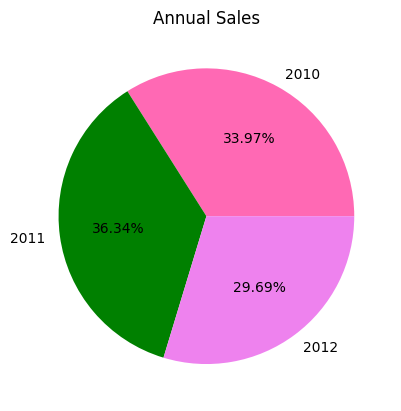

In [140]:
plt.pie(data.groupby('year')['Weekly_Sales'].sum(),labels=data['year'].unique(),autopct='%1.2f%%',colors=['hotpink','green','violet'])
plt.title('Annual Sales')

([<matplotlib.patches.Wedge at 0x7f663baabc70>,
 [Text(0.9433235218927056, 0.5658098028878099, 'Friday'),
  Text(0.08578965446731245, 1.0966495042566606, 'Monday'),
  Text(-0.8546394313524055, 0.6925254091927873, 'Saturday'),
  Text(-1.0055140250355994, -0.4460286374849805, 'Thursday'),
  Text(-0.06973153905931473, -1.0977875534275379, 'Tuesday'),
  Text(0.9414423121709514, -0.5689344187638967, 'Wednesday')],
 [Text(0.5145401028505666, 0.3086235288478963, '17.20%'),
  Text(0.04679435698217042, 0.5981724568672694, '13.12%'),
  Text(-0.46616696255585743, 0.3777411322869748, '17.69%'),
  Text(-0.5484621954739632, -0.24328834771908026, '17.28%'),
  Text(-0.03803538494144439, -0.5987932109604751, '17.41%'),
  Text(0.5135139884568826, -0.31032786478030727, '17.30%')])

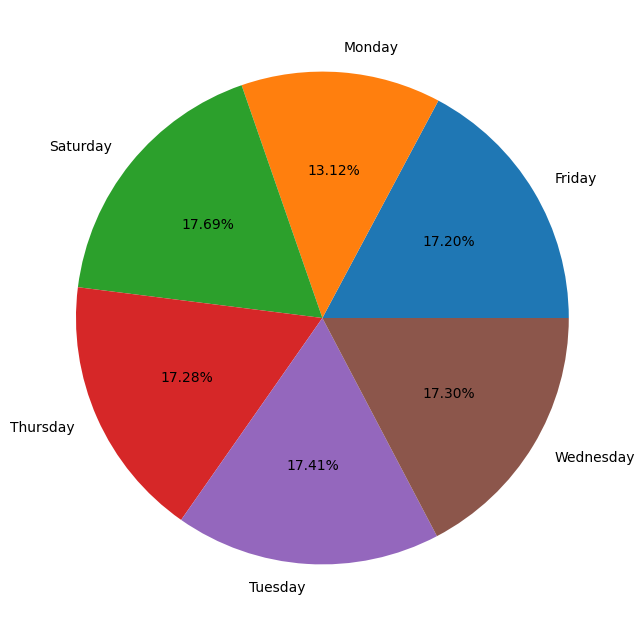

In [141]:
df2 = data.groupby('day')['Weekly_Sales'].sum().reset_index()
plt.figure(figsize=(10,8))
plt.pie(df2['Weekly_Sales'],labels= df2['day'],autopct='%1.2f%%')

([<matplotlib.patches.Wedge at 0x7f663dab6590>,
 [Text(1.0503377816992563, 0.32678822551476006, 'April'),
  Text(0.6930768429266986, 0.8541923025869296, 'August'),
  Text(0.13907870040044096, 1.0911723581061448, 'December'),
  Text(-0.4358537395908651, 1.0099660972946858, 'February'),
  Text(-0.8100149067981962, 0.7442283592854478, 'January'),
  Text(-1.0556568018997095, 0.30917424957922657, 'July'),
  Text(-1.0480601899933, -0.33402071515282983, 'June'),
  Text(-0.7048601208590872, -0.8444952397867694, 'March'),
  Text(-0.17449844294960315, -1.0860710351575371, 'May'),
  Text(0.31778497659832106, -1.053096723311019, 'Novemenber'),
  Text(0.7564980108166196, -0.7985679430270776, 'October'),
  Text(1.060183525248035, -0.2932761374415746, 'September')],
 [Text(0.5729115172905034, 0.1782481230080509, '9.60%'),
  Text(0.3780419143236537, 0.4659230741383252, '9.10%'),
  Text(0.07586110930933143, 0.5951849226033515, '8.56%'),
  Text(-0.23773840341319913, 0.5508905985243739, '8.44%'),
  Text(

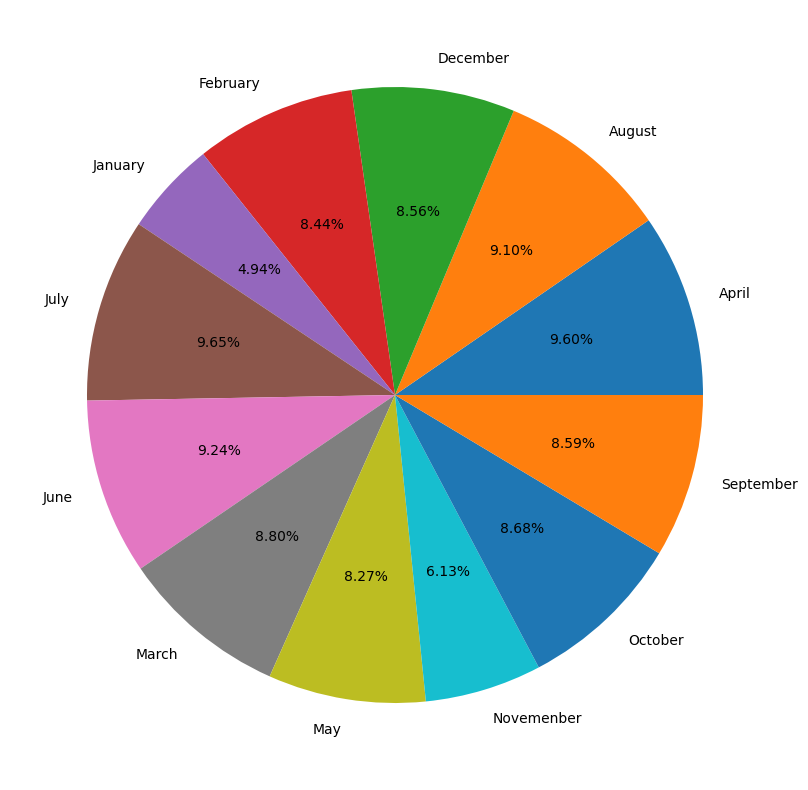

In [142]:
plt.figure(figsize=(10,10))
df3 = data.groupby('month')['Weekly_Sales'].sum().reset_index()
plt.pie(df3['Weekly_Sales'],labels=df3['month'],autopct='%1.2f%%')

([<matplotlib.patches.Wedge at 0x7f663e377fa0>,
 [Text(-0.25679386593526243, -1.0696059603508306, 'Non Special Holiday Week'),
  Text(0.3268284610531304, 1.361316699760068, 'Special Holiday Week')],
 [Text(-0.14006938141923403, -0.5834214329186348, '92.50%'),
  Text(0.2101040106770124, 0.8751321641314721, '7.50%')])

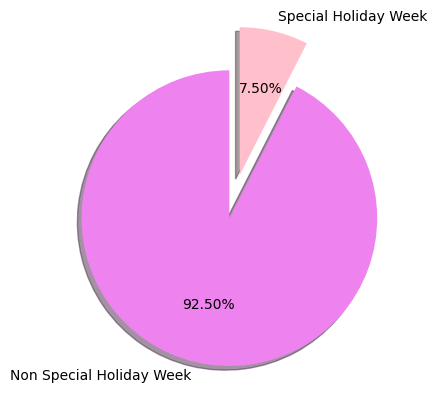

In [143]:
df4 = data.groupby('IsHoliday')['Weekly_Sales'].sum().reset_index()
plt.pie(df4['Weekly_Sales'],labels= ['Non Special Holiday Week','Special Holiday Week'],autopct='%1.2f%%',startangle=90,explode=[0,0.3],shadow=True,colors=['violet','pink'])

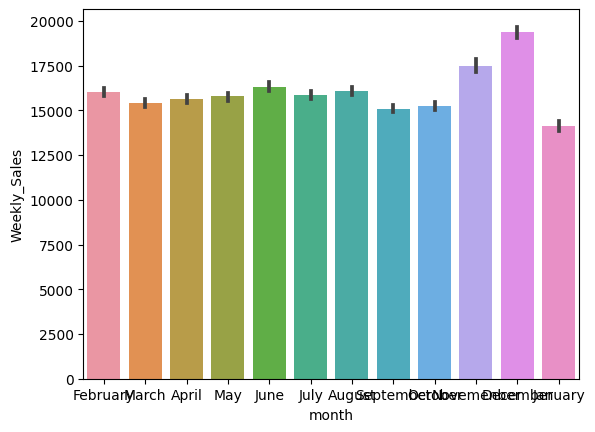

In [144]:
sns.barplot(x=data["month"],y=data["Weekly_Sales"] )
plt.show()

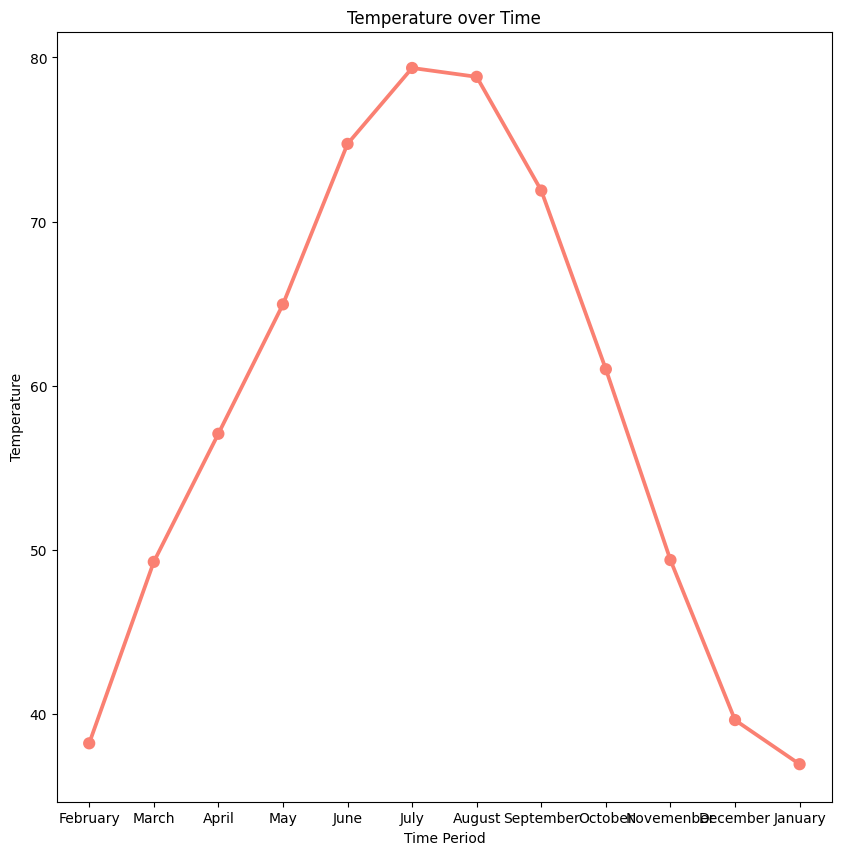

In [145]:
plt.figure(figsize=(10,10))
sns.pointplot(x="month", y="Temperature", data=data, color = 'salmon')
plt.xlabel('Time Period')
plt.ylabel('Temperature')
plt.title('Temperature over Time')
plt.show()
# inference: Graph clearly shows Temperature is more of a seasonal and repeated in cycles and this would 
# be an interesting data point that we can use for studies further

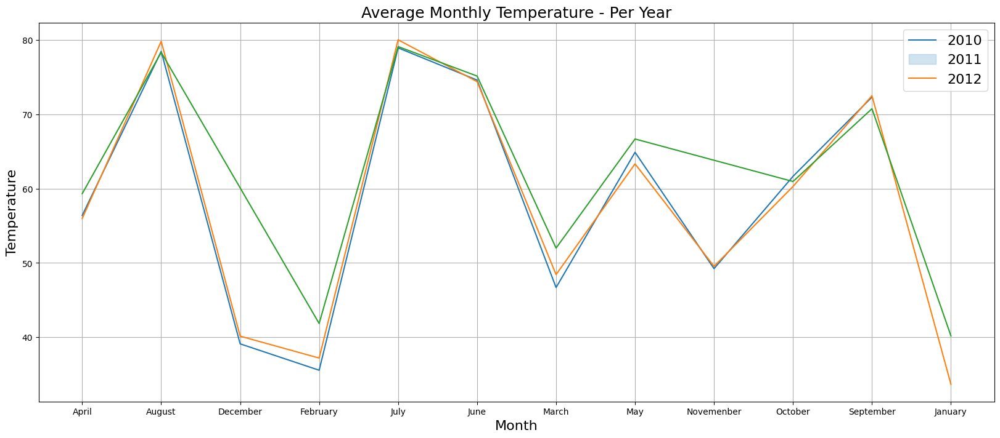

In [146]:
monthly_temp_2010 = data[data.year==2010]['Temperature'].groupby(data['month']).mean()
monthly_temp_2011 = data[data.year==2011]['Temperature'].groupby(data['month']).mean()
monthly_temp_2012 = data[data.year==2012]['Temperature'].groupby(data['month']).mean()
plt.figure(figsize=(20,8))
sns.lineplot(x=monthly_temp_2010.index, y=monthly_temp_2010.values)
sns.lineplot(x=monthly_temp_2011.index, y=monthly_temp_2011.values)
sns.lineplot(x=monthly_temp_2012.index, y=monthly_temp_2012.values)
plt.grid()
plt.xticks(np.arange(0, 12, step=1))
plt.legend(['2010', '2011', '2012'], loc='best', fontsize=16)
plt.title('Average Monthly Temperature - Per Year', fontsize=18)
plt.ylabel('Temperature', fontsize=16)
plt.xlabel('Month', fontsize=16)
plt.show()


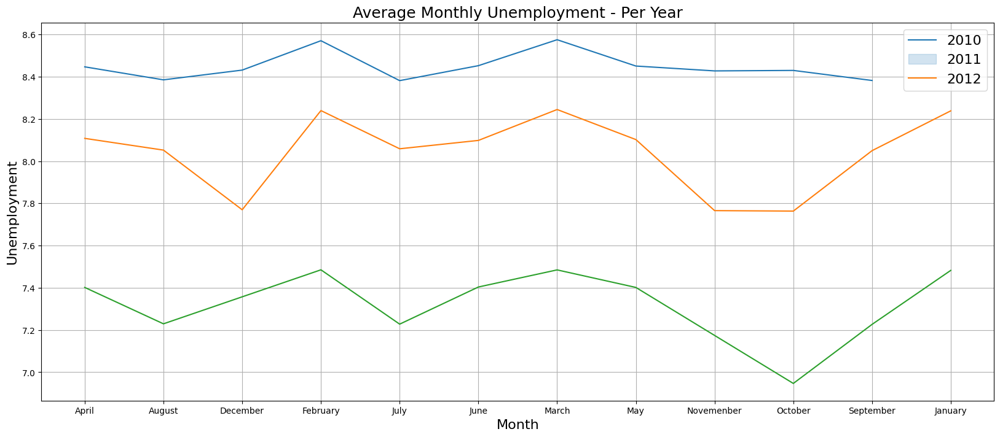

In [147]:
monthly_Unemp_2010 = data[data.year==2010]['Unemployment'].groupby(data['month']).mean()
monthly_Unemp_2011 = data[data.year==2011]['Unemployment'].groupby(data['month']).mean()
monthly_Unemp_2012 = data[data.year==2012]['Unemployment'].groupby(data['month']).mean()
plt.figure(figsize=(20,8))
sns.lineplot(x=monthly_Unemp_2010.index, y=monthly_Unemp_2010.values)
sns.lineplot(x=monthly_Unemp_2011.index, y=monthly_Unemp_2011.values)
sns.lineplot(x=monthly_Unemp_2012.index, y=monthly_Unemp_2012.values)
plt.grid()
plt.xticks(np.arange(0, 12, step=1))
plt.legend(['2010', '2011', '2012'], loc='best', fontsize=16)
plt.title('Average Monthly Unemployment - Per Year', fontsize=18)
plt.ylabel('Unemployment', fontsize=16)
plt.xlabel('Month', fontsize=16)
plt.show()


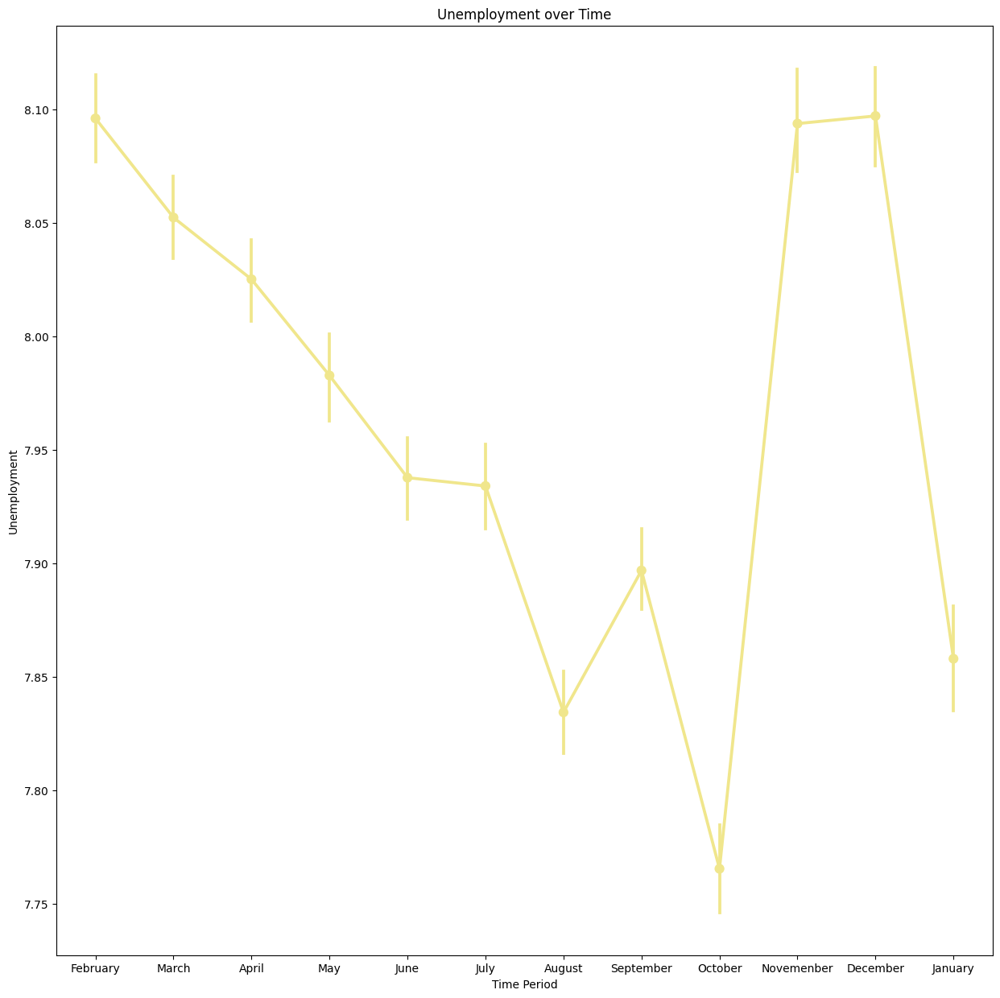

In [148]:
plt.figure(figsize=(15,15))
sns.pointplot(x="month", y="Unemployment", data=data, color='khaki')
plt.xlabel('Time Period')
plt.ylabel('Unemployment')
plt.title('Unemployment over Time')
plt.show()
# inference:  Over time unemployment have came down we can see this factor also whether it have affected the Sales


In [149]:

fig = px.line( data_frame = df_weeks, x = df_weeks.index, y = 'Weekly_Sales', labels = {'Weekly_Sales' : 'Weekly Sales', 'x' : 'Weeks' }, title = 'Sales over weeks')
fig.update_traces(line_color='blue', line_width=3)

##### Sales is less
**January(Week1 - Week4 ) , Week 44: October 30 to November 5, 2022 Week 45: November 6 to November 12, 2022 Week 46: November 13 to November 19, 2022 ( week before the Thanks giving ) , Week 48 ( Week after thanks giving ) , Week 52 ( Year End or Week after Christmas )**


This states that Holiday season has huge impact on sales based on the weekly sales forecast

In [150]:
data.head()

,Store,Dept,Date,Weekly_Sales,IsHoliday,Type,Size,Temperature,Fuel_Price,MarkDown1,...,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,Week,quarter,year,month,day
0,1,1,2010-02-05,24924.50,0,A,151315,42.31,2.572,-500.0,...,-500.0,-500.0,-500.0,211.096358,8.106,5,1,2010,February,Friday
1,1,2,2010-02-05,50605.27,0,A,151315,42.31,2.572,-500.0,...,-500.0,-500.0,-500.0,211.096358,8.106,5,1,2010,February,Friday
2,1,3,2010-02-05,13740.12,0,A,151315,42.31,2.572,-500.0,...,-500.0,-500.0,-500.0,211.096358,8.106,5,1,2010,February,Friday
3,1,4,2010-02-05,39954.04,0,A,151315,42.31,2.572,-500.0,...,-500.0,-500.0,-500.0,211.096358,8.106,5,1,2010,February,Friday
4,1,5,2010-02-05,32229.38,0,A,151315,42.31,2.572,-500.0,...,-500.0,-500.0,-500.0,211.096358,8.106,5,1,2010,February,Friday


In [151]:
plt.figure(figsize=[20,10])
df_quarter = data.groupby(["Store","Dept","year","quarter"])[["Weekly_Sales"]].sum().reset_index()


<Figure size 2000x1000 with 0 Axes>

In [152]:
print(df_quarter)


       Store  Dept  year  quarter  Weekly_Sales
0          1     1  2010        1     223200.22
1          1     1  2010        2     283951.61
2          1     1  2010        3     218407.09
3          1     1  2010        4     400789.81
4          1     1  2011        1     277732.56
...      ...   ...   ...      ...           ...
37261     45    98  2011        4      10665.02
37262     45    98  2012        1       9462.34
37263     45    98  2012        2       9449.91
37264     45    98  2012        3       7297.41
37265     45    98  2012        4       3525.93

[37266 rows x 5 columns]


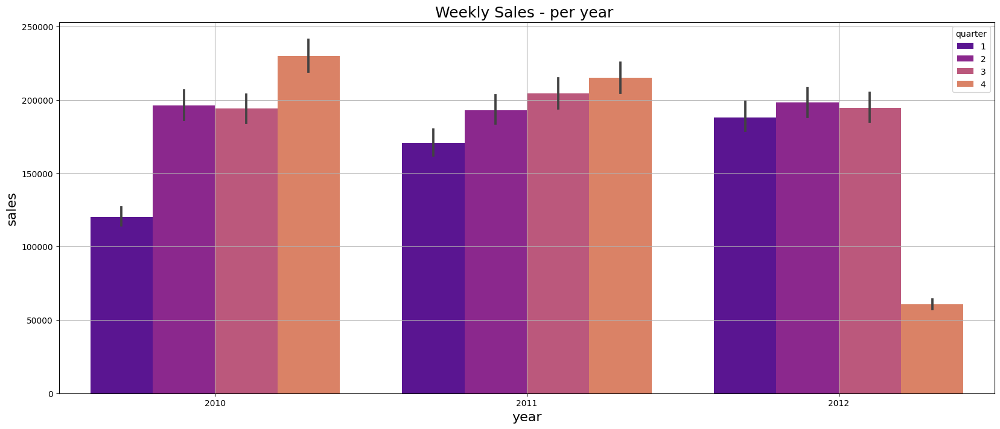

In [153]:
plt.figure(figsize=(20,8))
plt.style.use('default')
base_color = sns.color_palette('plasma',n_colors=5)
sns.barplot(data=df_quarter, x='year', y='Weekly_Sales',hue='quarter', palette = base_color)
plt.grid()
plt.title('Weekly Sales - per year ', fontsize=18)
plt.ylabel('sales', fontsize=16)
plt.xlabel('year', fontsize=16)
plt.show()

In [154]:
range(1,df_quarter["Store"].nunique()+1) 

range(1, 46)

for i in range(1,df_quarter["Store"].nunique()+1):   
    store = df_quarter.where(df_quarter["Store"]==i)
    #print(store)
    #print(store)
    dt = "Department wise Weekly Sales - per year in Store number" + str(i)
    dept_quarter = store.groupby(["Dept","year"])[["Weekly_Sales"]].sum().reset_index()
    #print(dept_quarter)
    plt.figure(figsize=(20,8))
    plt.style.use('default')
    base_color = sns.color_palette('pastel',n_colors=5)
    sns.barplot(data=dept_quarter, x='year', y='Weekly_Sales',hue='Dept')
    plt.grid()
    plt.title(dt, fontsize=18)
    plt.ylabel('sales', fontsize=16)
    plt.xlabel('year', fontsize=16)
    plt.show()
    #plt.tight_layout
    

### Modelling & Machine learning

# DATA PROCESSING FOR MODEL FIT

In [155]:
from sklearn.linear_model import LinearRegression,Lasso,Ridge,ElasticNet
from sklearn.metrics import mean_squared_error,mean_absolute_error,r2_score
from sklearn.svm import LinearSVR
from sklearn.ensemble import RandomForestRegressor,BaggingRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import cross_val_score

Text(0.5, 1.0, 'Correlation Matrix')

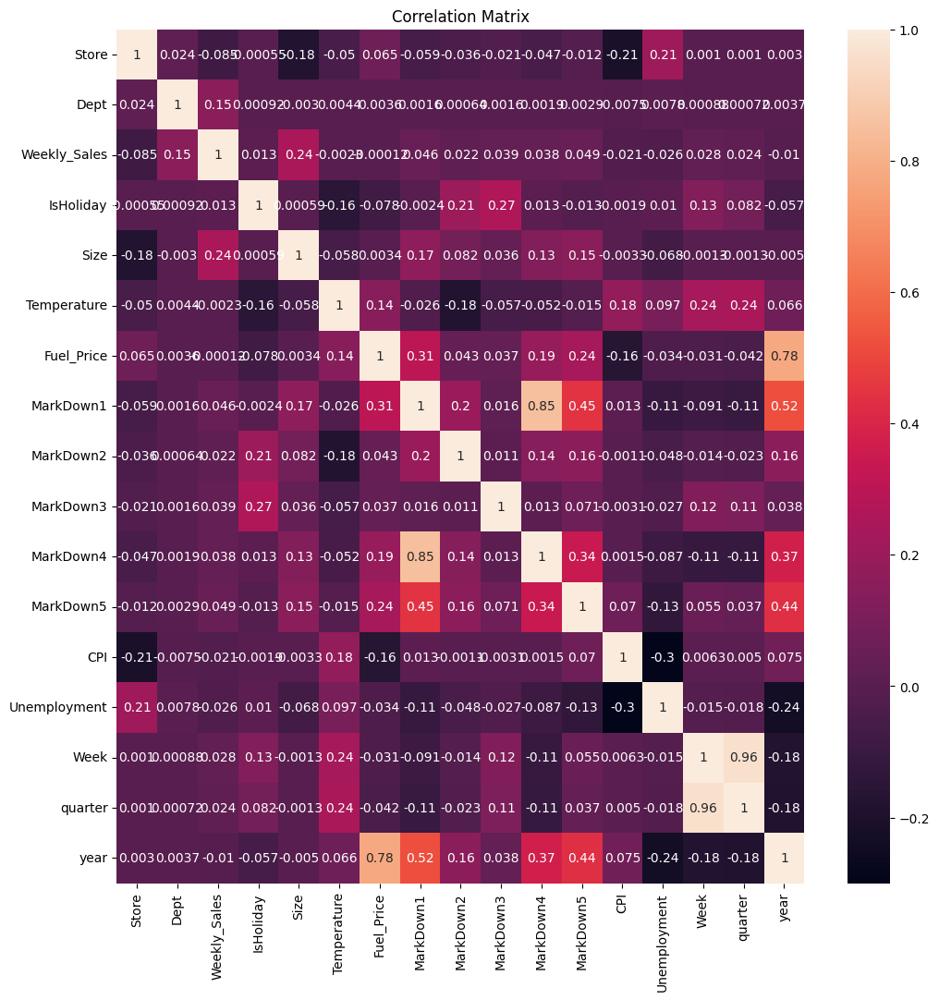

In [156]:
plt.figure(figsize=(12,12))
sns.heatmap(data.corr(),annot=True)
plt.title('Correlation Matrix')

In [157]:
data = data.drop(['CPI','Unemployment','Date','year','day'],axis=1)
test = test.drop(['CPI','Unemployment','Date','year','day'],axis=1)


print(data.head())
print(test.head())

   Store  Dept  Weekly_Sales  IsHoliday Type    Size  Temperature  Fuel_Price  \
0      1     1      24924.50          0    A  151315        42.31       2.572   
1      1     2      50605.27          0    A  151315        42.31       2.572   
2      1     3      13740.12          0    A  151315        42.31       2.572   
3      1     4      39954.04          0    A  151315        42.31       2.572   
4      1     5      32229.38          0    A  151315        42.31       2.572   

   MarkDown1  MarkDown2  MarkDown3  MarkDown4  MarkDown5  Week  quarter  \
0     -500.0     -500.0     -500.0     -500.0     -500.0     5        1   
1     -500.0     -500.0     -500.0     -500.0     -500.0     5        1   
2     -500.0     -500.0     -500.0     -500.0     -500.0     5        1   
3     -500.0     -500.0     -500.0     -500.0     -500.0     5        1   
4     -500.0     -500.0     -500.0     -500.0     -500.0     5        1   

      month  
0  February  
1  February  
2  February  
3  Feb

In [158]:
months={'January':1,'February':2,'March':3,'April':4,'May':5,'June':6,'July':7,'August':8,'September':9,'October':10,'Novemenber':11,'December':12}
data['month']= data['month'].map(months)


In [159]:
#data = data.drop(['Type','MarkDown1','MarkDown2','MarkDown3','MarkDown4','MarkDown5','Size','Fuel_Price'],axis=1)
#test = test.drop(['Type','MarkDown1','MarkDown2','MarkDown3','MarkDown4','MarkDown5','Size','Fuel_Price'],axis=1)

In [160]:
#data = data.drop(['Temperature','Week','month'],axis=1)
#test = test.drop(['Temperature','Week','month'],axis=1)

In [161]:
##test = test.drop(['Temperature','Week','month'],axis=1)

In [162]:
test['Type'].unique()

array(['A', 'B', 'C'], dtype=object)

In [163]:
Type={'A':13,'B':14,'C':15}
data['Type']= data['Type'].map(Type)
test['Type']= test['Type'].map(Type)

In [164]:
data.head()

,Store,Dept,Weekly_Sales,IsHoliday,Type,Size,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,Week,quarter,month
0,1,1,24924.50,0,13,151315,42.31,2.572,-500.0,-500.0,-500.0,-500.0,-500.0,5,1,2
1,1,2,50605.27,0,13,151315,42.31,2.572,-500.0,-500.0,-500.0,-500.0,-500.0,5,1,2
2,1,3,13740.12,0,13,151315,42.31,2.572,-500.0,-500.0,-500.0,-500.0,-500.0,5,1,2
3,1,4,39954.04,0,13,151315,42.31,2.572,-500.0,-500.0,-500.0,-500.0,-500.0,5,1,2
4,1,5,32229.38,0,13,151315,42.31,2.572,-500.0,-500.0,-500.0,-500.0,-500.0,5,1,2


In [165]:
test.head()

,Store,Dept,IsHoliday,Type,Size,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,Week,quarter,month
0,1,1,0,13,151315,55.32,3.386,6766.44,5147.7,50.82,3639.9,2737.42,44,4,11
1,1,2,0,13,151315,55.32,3.386,6766.44,5147.7,50.82,3639.9,2737.42,44,4,11
2,1,3,0,13,151315,55.32,3.386,6766.44,5147.7,50.82,3639.9,2737.42,44,4,11
3,1,4,0,13,151315,55.32,3.386,6766.44,5147.7,50.82,3639.9,2737.42,44,4,11
4,1,5,0,13,151315,55.32,3.386,6766.44,5147.7,50.82,3639.9,2737.42,44,4,11


In [166]:
x_train,x_test,y_train,y_test=train_test_split(data.drop(['Weekly_Sales'],axis=1),data['Weekly_Sales'],test_size=0.30,random_state=0)

In [167]:
models=[DecisionTreeRegressor(),LinearRegression(),RandomForestRegressor(),KNeighborsRegressor(n_neighbors = 5),BaggingRegressor(),LinearSVR()]
model_names=['DecisionTreeRegressor','LinearRegression','RandomForestRegressor','KNeighborsRegressor','BaggingRegressor','LinearSVR']
rmse=[]
d={}
acc_rf=[]

for model in range (len(models)):
    clf=models[model]
    clf.fit(x_train,y_train)
    test_pred=clf.predict(x_test)
    #rmsle.append(np.sqrt(mean_squared_log_error(test_pred,y_test)))
    acc_rf.append(round(clf.score(x_train, y_train) * 100, 2))
    rmse.append(np.sqrt(mean_squared_error(y_test,test_pred)))
d={'Modelling Algo':model_names,'RMSE':rmse,'Acc':acc_rf}   
d


{'Modelling Algo': ['DecisionTreeRegressor',
  'LinearRegression',
  'RandomForestRegressor',
  'KNeighborsRegressor',
  'BaggingRegressor',
  'LinearSVR'],
 'RMSE': [4754.128663351506,
  21751.014265830763,
  3715.3217555087326,
  17691.874929813082,
  4080.7804517730133,
  22658.562592974966],
 'Acc': [100.0, 8.67, 99.62, 59.92, 99.47, 1.06]}

In [168]:
clf=DecisionTreeRegressor()
clf.fit(x_train,y_train)
test_pred=clf.predict(test)
d={'Store':test['Store'],'Dept':test['Dept'],'Week':test['Week'],'Weekly_sales':test_pred}
ans=pd.DataFrame(d)
print(ans)

        Store  Dept  Week  Weekly_sales
0           1     1    44      39886.06
1           1     2    44      47344.50
2           1     3    44       9189.20
3           1     4    44      41124.27
4           1     5    44      31956.07
...       ...   ...   ...           ...
115059     45    93    30       4459.98
115060     45    94    30       5203.31
115061     45    95    30      51221.99
115062     45    97    30       5721.76
115063     45    98    30        599.03

[115064 rows x 4 columns]


In [169]:
ans.head()

,Store,Dept,Week,Weekly_sales
0,1,1,44,39886.06
1,1,2,44,47344.50
2,1,3,44,9189.20
3,1,4,44,41124.27
4,1,5,44,31956.07


In [170]:
storedata=[]
deptdata=[]
weekdata=[]
salesdata=[]

for i in range(1,ans["Store"].nunique()+1):
    store = ans.where(ans["Store"]==i)
    dept_sales_id = max(store[['Weekly_sales']].idxmax())
    print(dept_sales_id)
    deptnum=ans.iloc[dept_sales_id,1]
    week=ans.iloc[dept_sales_id,2]
    max_sale = ans.iloc[dept_sales_id,3]    
    storedata.append(i)
    deptdata.append(deptnum)
    weekdata.append(week)
    salesdata.append(max_sale)
d={'StoreNumber':storedata,'DepartmentNumber':deptdata,'Week':weekdata,'Max_Weekly_sales':salesdata}
final=pd.DataFrame(d)
    #print("Max Sales in Department" +str(s)+" in Week "+str(week)+"is "+str(max_sale))

final

#for i in range(1,ans["Store"].nunique()+1):
#     ans.sort_values("Weekly_sales", inplace = True)
#     filter1 = ans[["Store"]]==i
#     ans.where(filter1, inplace = True)
#     print(ans.shape)
#     filter2 = store_data["Weekly_sales"]==store_data["Weekly_sales"].max()
#     Dept_data = store_data.where(filter2, inplace = True)
    
#     print(Dept_data["Dept"])
#     #dt = "Max Sales in Department" + str(dept_value["Dept"]) + "in Store number" + str(i)
#     #print(dt)
   
    

266
3053
6126
8322
11098
13571
16352
19253
21907
24163
26941
29750
32330
35153
37925
40553
43174
45850
48559
51356
54115
56735
59593
62071
64916
67608
70246
73104
75756
78983
80283
83044
85613
87552
90300
93905
94496
96870
98605
101552
104056
106932
108872
110392
112687


,StoreNumber,DepartmentNumber,Week,Max_Weekly_sales
0,1,72,47,292555.25
1,2,72,47,392023.02
2,3,38,52,106070.32
3,4,72,47,392023.02
4,5,72,47,93517.72
5,6,72,47,392023.02
6,7,72,47,254641.96
7,8,7,51,341308.00
8,9,7,51,341308.00
9,10,72,47,392023.02


droping date column as timestap cnt be used to trai the models